# Welcome

By Samuel Alter

Assignment: Capstone EDA

BrainStation - Winter Data Science 2023

Last updated: 2023-03-05

# Table of Contents

# Initial Setup and Imports

In [1]:
# import packages
import pandas as pd
import numpy as np
# import seaborn as sns
# import matplotlib.pyplot as plt
from scipy.stats import norm
import statistics
# import plotly.express as px
import geopandas as gpd

In [3]:
df_fire_loc=pd.read_csv('/Users/sra/Desktop/Data_Science_2023/_capstone/WFIGS_-_Wildland_Fire_Locations_Full_History_2023-02-17.csv')

df_fire_loc.head()

/var/folders/n3/q8wb235x57n_sx2q14dsngjr0000gn/T/ipykernel_3283/4275461742.py:1: DtypeWarning: Columns (13,14,16,32,61,64,68,69,77,94,95) have mixed types. Specify dtype option on import or set low_memory=False.
  df_fire_loc=pd.read_csv('/Users/sra/Desktop/Data_Science_2023/_capstone/WFIGS_-_Wildland_Fire_Locations_Full_History_2023-02-17.csv')


,X,Y,OBJECTID,ABCDMisc,ADSPermissionState,CalculatedAcres,ContainmentDateTime,ControlDateTime,DailyAcres,DiscoveryAcres,...,IsDispatchComplete,OrganizationalAssessment,StrategicDecisionPublishDate,CreatedOnDateTime_dt,ModifiedOnDateTime_dt,Source,GlobalID,IsCpxChild,CpxName,CpxID
0,-104.457511,45.785037,1,NaN,CERTIFIED,50.64,2020/08/06 23:13:07+00,2020/08/06 23:13:24+00,50.6,20.0,...,0,NaN,NaN,2020/08/06 19:50:29+00,2020/08/12 20:46:01+00,IRWIN,{E5436898-ED0D-4CB1-90C0-D61915FE1F29},NaN,NaN,NaN
1,-118.180712,33.808985,2,NaN,DEFAULT,NaN,NaN,NaN,NaN,0.1,...,0,NaN,NaN,2020/02/28 20:52:36+00,2020/02/28 20:52:36+00,IRWIN,{0E79B7FD-2882-43CF-8CFA-911BD1C8F77A},NaN,NaN,NaN
2,-114.835414,48.073946,3,NaN,DEFAULT,NaN,2017/10/18 00:30:00+00,2017/10/18 00:35:00+00,50.0,50.0,...,0,NaN,NaN,2017/10/18 13:46:40+00,2017/11/09 22:08:19+00,IRWIN,{FAC59A92-E6AD-443B-8625-4AAABCF7F533},NaN,NaN,NaN
3,-117.153901,33.176394,4,NaN,DEFAULT,NaN,NaN,NaN,NaN,NaN,...,0,NaN,NaN,2019/07/01 20:10:12+00,2019/07/01 20:10:12+00,IRWIN,{5DF06F41-9948-49D3-B00A-2D3A1D1049C5},NaN,NaN,NaN
4,-121.104180,38.834727,5,NaN,DEFAULT,NaN,NaN,NaN,NaN,NaN,...,0,NaN,NaN,2016/06/20 22:39:02+00,2016/06/20 22:39:02+00,IRWIN,{F378818E-D541-4E0A-9A44-C81886C2B8B4},NaN,NaN,NaN


In [4]:
df_fire_loc.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 249674 entries, 0 to 249673
Data columns (total 96 columns):
 #   Column                           Non-Null Count   Dtype  
---  ------                           --------------   -----  
 0   X                                249674 non-null  float64
 1   Y                                249674 non-null  float64
 2   OBJECTID                         249674 non-null  int64  
 3   ABCDMisc                         13005 non-null   object 
 4   ADSPermissionState               249674 non-null  object 
 5   CalculatedAcres                  5350 non-null    float64
 6   ContainmentDateTime              151104 non-null  object 
 7   ControlDateTime                  136424 non-null  object 
 8   DailyAcres                       174047 non-null  float64
 9   DiscoveryAcres                   185208 non-null  float64
 10  DispatchCenterID                 212296 non-null  object 
 11  EstimatedCostToDate              14697 non-null   float64
 12  Fi

In [30]:
df_fire_perim=pd.read_csv('/Users/sra/Desktop/Data_Science_2023/_capstone/WFIGS_-_Wildland_Fire_Perimeters_Full_History_2023-02-17.csv')

df_fire_perim.head()

/var/folders/n3/q8wb235x57n_sx2q14dsngjr0000gn/T/ipykernel_5372/2156782238.py:1: DtypeWarning: Columns (40,69,72) have mixed types. Specify dtype option on import or set low_memory=False.
  df_fire_perim=pd.read_csv('/Users/sra/Desktop/Data_Science_2023/_capstone/WFIGS_-_Wildland_Fire_Perimeters_Full_History_2023-02-17.csv')


,OBJECTID,poly_IncidentName,poly_FeatureCategory,poly_MapMethod,poly_GISAcres,poly_CreateDate,poly_DateCurrent,poly_PolygonDateTime,poly_Acres_AutoCalc,poly_GlobalID,poly_Source,irwin_ABCDMisc,irwin_ADSPermissionState,irwin_CalculatedAcres,irwin_ContainmentDateTime,irwin_ControlDateTime,irwin_DailyAcres,irwin_DiscoveryAcres,irwin_DispatchCenterID,irwin_EstimatedCostToDate,irwin_FFReportApprovedByTitle,irwin_FFReportApprovedByUnit,irwin_FFReportApprovedDate,irwin_FireBehaviorGeneral,irwin_FireBehaviorGeneral1,irwin_FireBehaviorGeneral2,irwin_FireBehaviorGeneral3,irwin_FireCause,irwin_FireCauseGeneral,irwin_FireCauseSpecific,irwin_FireCode,irwin_FireDepartmentID,irwin_FireDiscoveryDateTime,irwin_FireMgmtComplexity,irwin_FireOutDateTime,irwin_FSConfinePercent,irwin_FSFullSuppPercent,irwin_FSMonitorPercent,irwin_FSPointZonePercent,irwin_FSJobCode,irwin_FSOverrideCode,irwin_GACC,irwin_ICS209ReportDateTime,irwin_ICS209RForTimePeriodFrom,irwin_ICS209RForTimePeriodTo,irwin_ICS209ReportStatus,irwin_IncidentManagementOrg,irwin_IncidentName,irwin_IncidentShortDescription,irwin_IncidentTypeCategory,irwin_IncidentTypeKind,irwin_InitialLatitude,irwin_InitialLongitude,irwin_InitialResponseAcres,irwin_InitialResponseDateTime,irwin_IrwinID,irwin_IsFireCauseInvestigated,irwin_IsFireCodeRequested,irwin_IsFSAssisted,irwin_IsMultiJurisdictional,irwin_IsReimbursable,irwin_IsTrespass,irwin_IsUnifiedCommand,irwin_LocalIncidentIdentifier,irwin_PercentContained,irwin_PercentPerToBeContained,irwin_POOCity,irwin_POOCounty,irwin_POODispatchCenterID,irwin_POOFips,irwin_POOJurisdictionalAgency,irwin_POOJurisdictionalUnit,irwin_POOJurisdUnitParentUnit,irwin_POOLandownerCategory,irwin_POOLandownerKind,irwin_POOLegalDescPrinMeridian,irwin_POOLegalDescQtr,irwin_POOLegalDescQtrQtr,irwin_POOLegalDescRange,irwin_POOLegalDescSection,irwin_POOLegalDescTownship,irwin_POOPredServiceAreaID,irwin_POOProtectingAgency,irwin_POOProtectingUnit,irwin_POOState,irwin_PredominantFuelGroup,irwin_PredominantFuelModel,irwin_PrimaryFuelModel,irwin_SecondaryFuelModel,irwin_TotalIncidentPersonnel,irwin_UniqueFireIdentifier,irwin_WFDSSDecisionStatus,irwin_CreatedBySystem,irwin_ModifiedBySystem,irwin_IsDispatchComplete,irwin_OrganizationalAssessment,irwin_StratDecisionPublishDate,irwin_GlobalID,irwin_Source,irwin_ArchivedOn,irwin_ModifiedOnDateTime_dt,irwin_CreatedOnDateTime_dt,GlobalID,irwin_IsCpxChild,irwin_CpxName,irwin_CpxID,SHAPE_Length,SHAPE_Area
0,127,Coleman,Wildfire Daily Fire Perimeter,Mixed Methods,562.913504,2021/05/04 22:50:38+00,2021/05/04 22:50:38+00,NaN,562.911767,{951569B8-EA6B-443B-8BF7-022AE1DFC937},2020 NIFS,NaN,DEFAULT,574.424,2020/11/15 23:00:00+00,2020/12/31 22:15:00+00,574.0,1.0,CALPCC,3925000.0,NaN,NaN,NaN,Minimal,Smoldering,Creeping,Isolated Torching,Unknown,NaN,NaN,NPD9,NaN,2020/10/18 19:24:00+00,Type 4 Incident,2021/03/10 16:15:00+00,2.0,98.0,0.0,0.0,P5,0507,OSCC,2020/11/20 00:00:00+00,2020/11/19 14:00:00+00,2020/11/20 00:00:00+00,F,Type 4 IC,COLEMAN,Coleman Reservoir Area,WF,FI,36.07114,-121.4505,3.0,NaN,{DB0B9472-74B9-4D89-8E78-A792C26FE4F2},NaN,0,0.0,0.0,0.0,1.0,0.0,003161,100.0,100.0,King City,Monterey,CALPCC,06053,FS,CALPF,NaN,USFS,Federal,Mount Diablo,NaN,NaN,06E,17.0,21S,SC07,FS,CALPF,US-CA,NaN,NaN,Brush (2 feet),Tall Grass (2.5 feet),1.0,2020-CALPF-003161,Approved Decision,wildcad,wildcad,0,Type 3 Incident,2020/10/20 14:14:11+00,NaN,IRWIN,NaN,2021/03/26 19:01:00+00,2020/10/18 20:02:59+00,{1E48F205-2208-4DBD-8A48-B739FDEACF9C},NaN,NaN,NaN,0.120036,-2.280138e-04
1,128,Patrick,Wildfire Daily Fire Perimeter,Mixed Methods,0.151680,2021/05/04 22:51:03+00,2021/05/04 22:51:03+00,NaN,0.151680,{08D5DE2B-51A0-420A-812F-35902565E93A},2020 NIFS,NaN,CERTIFIED,NaN,2020/05/01 20:39:00+00,2020/05/01 20:39:00+00,0.1,0.1,NVSFC,NaN,NaN,NaN,2020/06/19 20:31:59+00,NaN,NaN,NaN,NaN,Unknown,Cause and Origin Not Identified,NaN,M26Z,NaN,2020/05/01 18:56:59+00,NaN,NaN,NaN,NaN,NaN,NaN,PN,1502,GBCC,NaN,NaN,NaN,NaN,NaN,Patrick,NaN,WF,FI,39.55669,-119.5585,NaN,NaN,{8C96BC5C-225D-49

In [6]:
df_fire_perim.shape

(14705, 108)

In [7]:
df_fire_perim.info(verbose=True)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 14705 entries, 0 to 14704
Data columns (total 108 columns):
 #    Column                          Dtype  
---   ------                          -----  
 0    OBJECTID                        int64  
 1    poly_IncidentName               object 
 2    poly_FeatureCategory            object 
 3    poly_MapMethod                  object 
 4    poly_GISAcres                   float64
 5    poly_CreateDate                 object 
 6    poly_DateCurrent                object 
 7    poly_PolygonDateTime            object 
 8    poly_Acres_AutoCalc             float64
 9    poly_GlobalID                   object 
 10   poly_Source                     object 
 11   irwin_ABCDMisc                  object 
 12   irwin_ADSPermissionState        object 
 13   irwin_CalculatedAcres           float64
 14   irwin_ContainmentDateTime       object 
 15   irwin_ControlDateTime           object 
 16   irwin_DailyAcres                float64
 17   irwin_Disc

In [8]:
df_fire_loc['POOState'].value_counts()

US-CA    60310
US-AZ    17253
US-MT    17070
US-OR    15851
US-WA    12614
         ...  
CA-SK        2
MX-CA        1
CA-YT        1
MX-SO        1
MX-CH        1
Name: POOState, Length: 62, dtype: int64

In [9]:
df_fire_loc['POOCounty'].value_counts().head(10)

Los Angeles       16819
Riverside          8023
Coconino           4000
Lake               2863
Beltrami           2789
Lincoln            2527
Humboldt           2444
San Bernardino     2296
San Juan           2269
Benson             2201
Name: POOCounty, dtype: int64

In [10]:
selector=(df_fire_loc['POOState']=='US-CA')
df_fire_loc_CA=df_fire_loc[selector]
fire_loc_top10=df_fire_loc_CA['POOCounty'].value_counts().head(10)
fire_loc_top10

Los Angeles       16819
Riverside          8023
San Bernardino     2296
Siskiyou           2052
Humboldt           1930
Fresno             1769
San Diego          1704
Shasta             1664
El Dorado          1336
Plumas             1104
Name: POOCounty, dtype: int64

In [31]:
selector=(df_fire_perim['irwin_POOState']=='US-CA')
df_fire_perim_CA=df_fire_perim[selector]
fire_perim_top10=df_fire_perim_CA['irwin_POOCounty'].value_counts().head(10)
fire_perim_top10

Los Angeles       123
San Bernardino     85
Riverside          82
Siskiyou           76
San Diego          58
Shasta             51
Lassen             49
Trinity            49
Kern               42
Modoc              40
Name: irwin_POOCounty, dtype: int64

In [32]:
df_fire_perim['irwin_POOState'].value_counts()

US-MT    1197
US-CA    1088
US-ID    1076
US-TX    1031
US-MN     984
US-AZ     911
US-OR     734
US-NV     673
US-WY     658
US-AK     601
US-WA     578
US-SD     515
US-OK     487
US-UT     452
US-FL     381
US-MO     360
US-CO     334
US-MS     294
US-ME     289
US-MA     268
US-NM     240
US-MI     165
US-AR     160
US-KY     115
US-ND     112
US-WI     109
US-LA      93
US-NE      84
US-OH      82
US-AL      81
US-GA      68
US-KS      65
US-IN      64
US-IL      62
US-NC      59
US-VA      55
US-TN      35
US-SC      34
US-IA      24
US-PA      15
US-HI      13
US-NY      10
US-MD      10
US-WV      10
US-GU      10
US-NH       9
US-VT       4
US-NJ       4
MX-CA       1
US-CT       1
Name: irwin_POOState, dtype: int64

In [13]:
df_fire_loc[df_fire_loc['POOState']=='US-CA']

,X,Y,OBJECTID,ABCDMisc,ADSPermissionState,CalculatedAcres,ContainmentDateTime,ControlDateTime,DailyAcres,DiscoveryAcres,...,IsDispatchComplete,OrganizationalAssessment,StrategicDecisionPublishDate,CreatedOnDateTime_dt,ModifiedOnDateTime_dt,Source,GlobalID,IsCpxChild,CpxName,CpxID
1,-118.180712,33.808985,2,NaN,DEFAULT,NaN,NaN,NaN,NaN,0.10,...,0,NaN,NaN,2020/02/28 20:52:36+00,2020/02/28 20:52:36+00,IRWIN,{0E79B7FD-2882-43CF-8CFA-911BD1C8F77A},NaN,NaN,NaN
3,-117.153901,33.176394,4,NaN,DEFAULT,NaN,NaN,NaN,NaN,NaN,...,0,NaN,NaN,2019/07/01 20:10:12+00,2019/07/01 20:10:12+00,IRWIN,{5DF06F41-9948-49D3-B00A-2D3A1D1049C5},NaN,NaN,NaN
4,-121.104180,38.834727,5,NaN,DEFAULT,NaN,NaN,NaN,NaN,NaN,...,0,NaN,NaN,2016/06/20 22:39:02+00,2016/06/20 22:39:02+00,IRWIN,{F378818E-D541-4E0A-9A44-C81886C2B8B4},NaN,NaN,NaN
9,-119.693013,37.638805,10,NaN,DEFAULT,NaN,2015/06/09 08:26:59+00,2015/06/09 08:26:59+00,NaN,0.10,...,0,NaN,NaN,2015/06/09 04:22:58+00,2015/06/09 16:57:55+00,IRWIN,{90A83344-596C-4558-97D9-8F12879B1440},NaN,NaN,NaN
12,-121.191680,39.678339,14,NaN,DEFAULT,NaN,NaN,NaN,NaN,NaN,...,0,NaN,NaN,2017/07/07 21:58:52+00,2017/07/07 21:58:52+00,IRWIN,{DF8A849A-D717-45B3-8BF8-B99084C9C398},NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
249660,-117.044084,33.869725,296661,NaN,DEFAULT,NaN,NaN,NaN,0.01,0.01,...,0,NaN,NaN,2023/02/17 05:41:40+00,2023/02/17 05:43:06+00,IRWIN,{501776DF-C837-41D9-9F87-6A160FF9E6C1},0.0,NaN,NaN
249661,-117.960742,34.005935,296662,NaN,DEFAULT,NaN,NaN,NaN,NaN,0.01,...,0,NaN,NaN,2023/02/17 05:46:49+00,2023/02/17 05:46:49+00,IRWIN,{532E2DB6-5D94-4C6B-BB0C-28111E0B8A28},0.0,NaN,NaN
249662,-118.179712,33.912615,296664,NaN,DEFAULT,NaN,NaN,NaN,NaN,0.01,...,0,NaN,NaN,2023/02/17 07:02:49+00,2023/02/17 07:02:49+00,IRWIN,{3DE7EA92-E641-4E7D-99F9-D6B94EBC191F},0.0,NaN,NaN
249664,-118.580502,34.048275,296667,NaN,DEFAULT,NaN,NaN,NaN,NaN,0.01,...,0,NaN,NaN,2023/02/17 09:06:49+00,2023/02/17 09:06:51+00,IRWIN,{E88F18EB-2BB5-4FD0-83F0-10FA940FB8DA},0.0,NaN,NaN


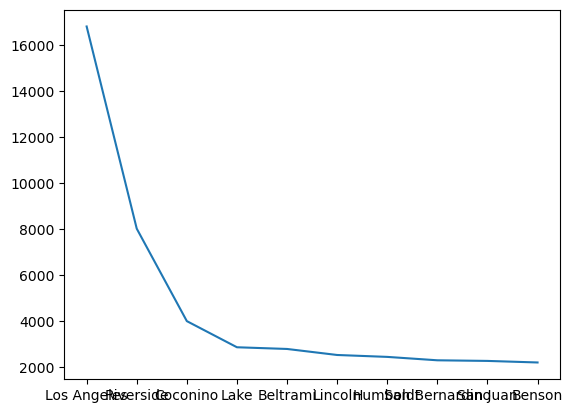

In [14]:
values=df_fire_loc['POOCounty'].value_counts()
top_val=values[:10]

top_val

plt.figure()
plt.plot(top_val)
plt.show()

In [15]:
pd.options.display.max_columns=None
display(df_fire_perim)

,OBJECTID,poly_IncidentName,poly_FeatureCategory,poly_MapMethod,poly_GISAcres,poly_CreateDate,poly_DateCurrent,poly_PolygonDateTime,poly_Acres_AutoCalc,poly_GlobalID,poly_Source,irwin_ABCDMisc,irwin_ADSPermissionState,irwin_CalculatedAcres,irwin_ContainmentDateTime,irwin_ControlDateTime,irwin_DailyAcres,irwin_DiscoveryAcres,irwin_DispatchCenterID,irwin_EstimatedCostToDate,irwin_FFReportApprovedByTitle,irwin_FFReportApprovedByUnit,irwin_FFReportApprovedDate,irwin_FireBehaviorGeneral,irwin_FireBehaviorGeneral1,irwin_FireBehaviorGeneral2,irwin_FireBehaviorGeneral3,irwin_FireCause,irwin_FireCauseGeneral,irwin_FireCauseSpecific,irwin_FireCode,irwin_FireDepartmentID,irwin_FireDiscoveryDateTime,irwin_FireMgmtComplexity,irwin_FireOutDateTime,irwin_FSConfinePercent,irwin_FSFullSuppPercent,irwin_FSMonitorPercent,irwin_FSPointZonePercent,irwin_FSJobCode,irwin_FSOverrideCode,irwin_GACC,irwin_ICS209ReportDateTime,irwin_ICS209RForTimePeriodFrom,irwin_ICS209RForTimePeriodTo,irwin_ICS209ReportStatus,irwin_IncidentManagementOrg,irwin_IncidentName,irwin_IncidentShortDescription,irwin_IncidentTypeCategory,irwin_IncidentTypeKind,irwin_InitialLatitude,irwin_InitialLongitude,irwin_InitialResponseAcres,irwin_InitialResponseDateTime,irwin_IrwinID,irwin_IsFireCauseInvestigated,irwin_IsFireCodeRequested,irwin_IsFSAssisted,irwin_IsMultiJurisdictional,irwin_IsReimbursable,irwin_IsTrespass,irwin_IsUnifiedCommand,irwin_LocalIncidentIdentifier,irwin_PercentContained,irwin_PercentPerToBeContained,irwin_POOCity,irwin_POOCounty,irwin_POODispatchCenterID,irwin_POOFips,irwin_POOJurisdictionalAgency,irwin_POOJurisdictionalUnit,irwin_POOJurisdUnitParentUnit,irwin_POOLandownerCategory,irwin_POOLandownerKind,irwin_POOLegalDescPrinMeridian,irwin_POOLegalDescQtr,irwin_POOLegalDescQtrQtr,irwin_POOLegalDescRange,irwin_POOLegalDescSection,irwin_POOLegalDescTownship,irwin_POOPredServiceAreaID,irwin_POOProtectingAgency,irwin_POOProtectingUnit,irwin_POOState,irwin_PredominantFuelGroup,irwin_PredominantFuelModel,irwin_PrimaryFuelModel,irwin_SecondaryFuelModel,irwin_TotalIncidentPersonnel,irwin_UniqueFireIdentifier,irwin_WFDSSDecisionStatus,irwin_CreatedBySystem,irwin_ModifiedBySystem,irwin_IsDispatchComplete,irwin_OrganizationalAssessment,irwin_StratDecisionPublishDate,irwin_GlobalID,irwin_Source,irwin_ArchivedOn,irwin_ModifiedOnDateTime_dt,irwin_CreatedOnDateTime_dt,GlobalID,irwin_IsCpxChild,irwin_CpxName,irwin_CpxID,SHAPE_Length,SHAPE_Area
0,127,Coleman,Wildfire Daily Fire Perimeter,Mixed Methods,562.913504,2021/05/04 22:50:38+00,2021/05/04 22:50:38+00,NaN,562.911767,{951569B8-EA6B-443B-8BF7-022AE1DFC937},2020 NIFS,NaN,DEFAULT,574.424,2020/11/15 23:00:00+00,2020/12/31 22:15:00+00,574.00,1.00,CALPCC,3925000.0,NaN,NaN,NaN,Minimal,Smoldering,Creeping,Isolated Torching,Unknown,NaN,NaN,NPD9,NaN,2020/10/18 19:24:00+00,Type 4 Incident,2021/03/10 16:15:00+00,2.0,98.0,0.0,0.0,P5,0507,OSCC,2020/11/20 00:00:00+00,2020/11/19 14:00:00+00,2020/11/20 00:00:00+00,F,Type 4 IC,COLEMAN,Coleman Reservoir Area,WF,FI,36.071140,-121.450500,3.0,NaN,{DB0B9472-74B9-4D89-8E78-A792C26FE4F2},NaN,0,0.0,0.0,0.0,1.0,0.0,003161,100.0,100.0,King City,Monterey,CALPCC,06053,FS,CALPF,NaN,USFS,Federal,Mount Diablo,NaN,NaN,06E,17.0,21S,SC07,FS,CALPF,US-CA,NaN,NaN,Brush (2 feet),Tall Grass (2.5 feet),1.0,2020-CALPF-003161,Approved Decision,wildcad,wildcad,0,Type 3 Incident,2020/10/20 14:14:11+00,NaN,IRWIN,NaN,2021/03/26 19:01:00+00,2020/10/18 20:02:59+00,{1E48F205-2208-4DBD-8A48-B739FDEACF9C},NaN,NaN,NaN,0.120036,-2.280138e-04
1,128,Patrick,Wildfire Daily Fire Perimeter,Mixed Methods,0.151680,2021/05/04 22:51:03+00,2021/05/04 22:51:03+00,NaN,0.151680,{08D5DE2B-51A0-420A-812F-35902565E93A},2020 NIFS,NaN,CERTIFIED,NaN,2020/05/01 20:39:00+00,2020/05/01 20:39:00+00,0.10,0.10,NVSFC,NaN,NaN,NaN,2020/06/19 20:31:59+00,NaN,NaN,NaN,NaN,Unknown,Cause and Origin Not Identified,NaN,M26Z,NaN,2020/05/01 18:56:59+00,NaN,NaN,NaN,NaN,NaN,NaN,PN,1502,GBCC,NaN,NaN,NaN,NaN,NaN,Patrick,NaN,WF,FI,39.556690,-119.558500,NaN,NaN,{8C96BC

In [16]:
df_fire_perim.groupby(['OBJECTID']).get_group(127)

,OBJECTID,poly_IncidentName,poly_FeatureCategory,poly_MapMethod,poly_GISAcres,poly_CreateDate,poly_DateCurrent,poly_PolygonDateTime,poly_Acres_AutoCalc,poly_GlobalID,poly_Source,irwin_ABCDMisc,irwin_ADSPermissionState,irwin_CalculatedAcres,irwin_ContainmentDateTime,irwin_ControlDateTime,irwin_DailyAcres,irwin_DiscoveryAcres,irwin_DispatchCenterID,irwin_EstimatedCostToDate,irwin_FFReportApprovedByTitle,irwin_FFReportApprovedByUnit,irwin_FFReportApprovedDate,irwin_FireBehaviorGeneral,irwin_FireBehaviorGeneral1,irwin_FireBehaviorGeneral2,irwin_FireBehaviorGeneral3,irwin_FireCause,irwin_FireCauseGeneral,irwin_FireCauseSpecific,irwin_FireCode,irwin_FireDepartmentID,irwin_FireDiscoveryDateTime,irwin_FireMgmtComplexity,irwin_FireOutDateTime,irwin_FSConfinePercent,irwin_FSFullSuppPercent,irwin_FSMonitorPercent,irwin_FSPointZonePercent,irwin_FSJobCode,irwin_FSOverrideCode,irwin_GACC,irwin_ICS209ReportDateTime,irwin_ICS209RForTimePeriodFrom,irwin_ICS209RForTimePeriodTo,irwin_ICS209ReportStatus,irwin_IncidentManagementOrg,irwin_IncidentName,irwin_IncidentShortDescription,irwin_IncidentTypeCategory,irwin_IncidentTypeKind,irwin_InitialLatitude,irwin_InitialLongitude,irwin_InitialResponseAcres,irwin_InitialResponseDateTime,irwin_IrwinID,irwin_IsFireCauseInvestigated,irwin_IsFireCodeRequested,irwin_IsFSAssisted,irwin_IsMultiJurisdictional,irwin_IsReimbursable,irwin_IsTrespass,irwin_IsUnifiedCommand,irwin_LocalIncidentIdentifier,irwin_PercentContained,irwin_PercentPerToBeContained,irwin_POOCity,irwin_POOCounty,irwin_POODispatchCenterID,irwin_POOFips,irwin_POOJurisdictionalAgency,irwin_POOJurisdictionalUnit,irwin_POOJurisdUnitParentUnit,irwin_POOLandownerCategory,irwin_POOLandownerKind,irwin_POOLegalDescPrinMeridian,irwin_POOLegalDescQtr,irwin_POOLegalDescQtrQtr,irwin_POOLegalDescRange,irwin_POOLegalDescSection,irwin_POOLegalDescTownship,irwin_POOPredServiceAreaID,irwin_POOProtectingAgency,irwin_POOProtectingUnit,irwin_POOState,irwin_PredominantFuelGroup,irwin_PredominantFuelModel,irwin_PrimaryFuelModel,irwin_SecondaryFuelModel,irwin_TotalIncidentPersonnel,irwin_UniqueFireIdentifier,irwin_WFDSSDecisionStatus,irwin_CreatedBySystem,irwin_ModifiedBySystem,irwin_IsDispatchComplete,irwin_OrganizationalAssessment,irwin_StratDecisionPublishDate,irwin_GlobalID,irwin_Source,irwin_ArchivedOn,irwin_ModifiedOnDateTime_dt,irwin_CreatedOnDateTime_dt,GlobalID,irwin_IsCpxChild,irwin_CpxName,irwin_CpxID,SHAPE_Length,SHAPE_Area
0,127,Coleman,Wildfire Daily Fire Perimeter,Mixed Methods,562.913504,2021/05/04 22:50:38+00,2021/05/04 22:50:38+00,NaN,562.911767,{951569B8-EA6B-443B-8BF7-022AE1DFC937},2020 NIFS,NaN,DEFAULT,574.424,2020/11/15 23:00:00+00,2020/12/31 22:15:00+00,574.0,1.0,CALPCC,3925000.0,NaN,NaN,NaN,Minimal,Smoldering,Creeping,Isolated Torching,Unknown,NaN,NaN,NPD9,NaN,2020/10/18 19:24:00+00,Type 4 Incident,2021/03/10 16:15:00+00,2.0,98.0,0.0,0.0,P5,0507,OSCC,2020/11/20 00:00:00+00,2020/11/19 14:00:00+00,2020/11/20 00:00:00+00,F,Type 4 IC,COLEMAN,Coleman Reservoir Area,WF,FI,36.07114,-121.4505,3.0,NaN,{DB0B9472-74B9-4D89-8E78-A792C26FE4F2},NaN,0,0.0,0.0,0.0,1.0,0.0,003161,100.0,100.0,King City,Monterey,CALPCC,06053,FS,CALPF,NaN,USFS,Federal,Mount Diablo,NaN,NaN,06E,17.0,21S,SC07,FS,CALPF,US-CA,NaN,NaN,Brush (2 feet),Tall Grass (2.5 feet),1.0,2020-CALPF-003161,Approved Decision,wildcad,wildcad,0,Type 3 Incident,2020/10/20 14:14:11+00,NaN,IRWIN,NaN,2021/03/26 19:01:00+00,2020/10/18 20:02:59+00,{1E48F205-2208-4DBD-8A48-B739FDEACF9C},NaN,NaN,NaN,0.120036,-0.000228


In [17]:
df_fire_perim.groupby(['OBJECTID']).agg({'poly_GISAcres':'max'})

,poly_GISAcres
OBJECTID,
127,562.913504
128,0.151680
129,0.300000
130,44.300517
133,NaN
...,...
21014,0.100000
21015,10.170000
21016,10.170000


In [18]:
df_fire_perim['poly_CreateDate'].max()

'2023/02/17 04:13:57+00'

In [19]:
df_fire_loc.head()

,X,Y,OBJECTID,ABCDMisc,ADSPermissionState,CalculatedAcres,ContainmentDateTime,ControlDateTime,DailyAcres,DiscoveryAcres,DispatchCenterID,EstimatedCostToDate,FinalFireReportApprovedByTitle,FinalFireReportApprovedByUnit,FinalFireReportApprovedDate,FireBehaviorGeneral,FireBehaviorGeneral1,FireBehaviorGeneral2,FireBehaviorGeneral3,FireCause,FireCauseGeneral,FireCauseSpecific,FireCode,FireDepartmentID,FireDiscoveryDateTime,FireMgmtComplexity,FireOutDateTime,FireStrategyConfinePercent,FireStrategyFullSuppPercent,FireStrategyMonitorPercent,FireStrategyPointZonePercent,FSJobCode,FSOverrideCode,GACC,ICS209ReportDateTime,ICS209ReportForTimePeriodFrom,ICS209ReportForTimePeriodTo,ICS209ReportStatus,IncidentManagementOrganization,IncidentName,IncidentShortDescription,IncidentTypeCategory,IncidentTypeKind,InitialLatitude,InitialLongitude,InitialResponseAcres,InitialResponseDateTime,IrwinID,IsFireCauseInvestigated,IsFireCodeRequested,IsFSAssisted,IsMultiJurisdictional,IsReimbursable,IsTrespass,IsUnifiedCommand,LocalIncidentIdentifier,PercentContained,PercentPerimeterToBeContained,POOCity,POOCounty,POODispatchCenterID,POOFips,POOJurisdictionalAgency,POOJurisdictionalUnit,POOJurisdictionalUnitParentUnit,POOLandownerCategory,POOLandownerKind,POOLegalDescPrincipalMeridian,POOLegalDescQtr,POOLegalDescQtrQtr,POOLegalDescRange,POOLegalDescSection,POOLegalDescTownship,POOPredictiveServiceAreaID,POOProtectingAgency,POOProtectingUnit,POOState,PredominantFuelGroup,PredominantFuelModel,PrimaryFuelModel,SecondaryFuelModel,TotalIncidentPersonnel,UniqueFireIdentifier,WFDSSDecisionStatus,CreatedBySystem,ModifiedBySystem,IsDispatchComplete,OrganizationalAssessment,StrategicDecisionPublishDate,CreatedOnDateTime_dt,ModifiedOnDateTime_dt,Source,GlobalID,IsCpxChild,CpxName,CpxID
0,-104.457511,45.785037,1,NaN,CERTIFIED,50.64,2020/08/06 23:13:07+00,2020/08/06 23:13:24+00,50.6,20.0,MTMCC,NaN,NaN,NaN,2020/08/12 20:45:59+00,NaN,NaN,NaN,NaN,Human,Equipment,Farming Equipment,NDU0,NaN,2020/08/06 18:58:00+00,NaN,2020/08/12 14:00:00+00,NaN,NaN,NaN,NaN,PN,1502,NRCC,NaN,NaN,NaN,NaN,NaN,Ramme,NaN,WF,FI,45.78496,-104.4958,NaN,NaN,{FE67856C-7401-44BD-B6F3-9A57EF990079},NaN,0,1.0,0.0,0.0,0.0,NaN,000224,NaN,NaN,NaN,Carter,MTMCC,30011.0,C&L,MTLG42,NaN,Private,Private,NaN,NaN,NaN,NaN,NaN,NaN,NR16,C&L,MTLG42,US-MT,Grass,GR4,NaN,NaN,NaN,2020-MTLG42-000224,No Decision,wildcad,INFORM_Inspector,0,NaN,NaN,2020/08/06 19:50:29+00,2020/08/12 20:46:01+00,IRWIN,{E5436898-ED0D-4CB1-90C0-D61915FE1F29},NaN,NaN,NaN
1,-118.180712,33.808985,2,NaN,DEFAULT,NaN,NaN,NaN,NaN,0.1,CALACC,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Unknown,NaN,NaN,NaN,NaN,2020/02/28 20:45:40+00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,OSCC,NaN,NaN,NaN,NaN,NaN,LAC-066100,NaN,WF,FI,33.80898,-118.1807,NaN,NaN,{6A311ABB-DF4F-4947-B8DD-3900BDA784F6},NaN,0,NaN,NaN,NaN,NaN,NaN,066100,NaN,NaN,NaN,Los Angeles,CALACC,6037.0,NaN,CACAS,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,SC08,C&L,CALAC,US-CA,NaN,NaN,NaN,NaN,NaN,2020-CALAC-066100,No Decision,lacocad,lacocad,0,NaN,NaN,2020/02/28 20:52:36+00,2020/02/28 20:52:36+00,IRWIN,{0E79B7FD-2882-43CF-8CFA-911BD1C8F77A},NaN,NaN,NaN
2,-114.835414,48.073946,3,NaN,DEFAULT,NaN,2017/10/18 00:30:00+00,2017/10/18 00:35:00+00,50.0,50.0,MTKIC,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Human,NaN,NaN,NaN,NaN,2017/10/17 20:20:24+00,NaN,2017/11/09 21:59:59+00,NaN,NaN,NaN,NaN,NaN,NaN,NRCC,NaN,NaN,NaN,NaN,NaN,South Lost Prairie,NaN,WF,FI,48.07167,-114.8303,1.0,NaN,{9599AE8E-66B8-4412-B849-7271271B0463},NaN,0,0.0,0.0,0.0,0.0,NaN,000878,NaN,NaN,NaN,Flathead,NaN,30029.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NR02,DNRC,MTNWS,US-MT,NaN,NaN,NaN,NaN,NaN,2017-MTNWS-000878,NaN,wildcad,wildcad,0,NaN,NaN,2017/10/18 13:46:40+00,2017/11/09 22:08:19+00,IRWIN,{FAC59A92-E6AD-443B-8625-4AAABCF7F533},NaN,NaN,NaN
3,-117.153901,33.176394,4,NaN,DEFAULT,NaN,NaN,NaN,NaN,NaN,CAMVIC,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,MC2S,NaN,2019/07/01 19:54:00+00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,OSCC,NaN,NaN,NaN,NaN,NaN,SYCAMORE,NaN,WF,FI,NaN,NaN,NaN,NaN,{1AF2C949-B159-4

In [20]:
df_fire_loc.groupby(['OBJECTID']).get_group(1)

,X,Y,OBJECTID,ABCDMisc,ADSPermissionState,CalculatedAcres,ContainmentDateTime,ControlDateTime,DailyAcres,DiscoveryAcres,DispatchCenterID,EstimatedCostToDate,FinalFireReportApprovedByTitle,FinalFireReportApprovedByUnit,FinalFireReportApprovedDate,FireBehaviorGeneral,FireBehaviorGeneral1,FireBehaviorGeneral2,FireBehaviorGeneral3,FireCause,FireCauseGeneral,FireCauseSpecific,FireCode,FireDepartmentID,FireDiscoveryDateTime,FireMgmtComplexity,FireOutDateTime,FireStrategyConfinePercent,FireStrategyFullSuppPercent,FireStrategyMonitorPercent,FireStrategyPointZonePercent,FSJobCode,FSOverrideCode,GACC,ICS209ReportDateTime,ICS209ReportForTimePeriodFrom,ICS209ReportForTimePeriodTo,ICS209ReportStatus,IncidentManagementOrganization,IncidentName,IncidentShortDescription,IncidentTypeCategory,IncidentTypeKind,InitialLatitude,InitialLongitude,InitialResponseAcres,InitialResponseDateTime,IrwinID,IsFireCauseInvestigated,IsFireCodeRequested,IsFSAssisted,IsMultiJurisdictional,IsReimbursable,IsTrespass,IsUnifiedCommand,LocalIncidentIdentifier,PercentContained,PercentPerimeterToBeContained,POOCity,POOCounty,POODispatchCenterID,POOFips,POOJurisdictionalAgency,POOJurisdictionalUnit,POOJurisdictionalUnitParentUnit,POOLandownerCategory,POOLandownerKind,POOLegalDescPrincipalMeridian,POOLegalDescQtr,POOLegalDescQtrQtr,POOLegalDescRange,POOLegalDescSection,POOLegalDescTownship,POOPredictiveServiceAreaID,POOProtectingAgency,POOProtectingUnit,POOState,PredominantFuelGroup,PredominantFuelModel,PrimaryFuelModel,SecondaryFuelModel,TotalIncidentPersonnel,UniqueFireIdentifier,WFDSSDecisionStatus,CreatedBySystem,ModifiedBySystem,IsDispatchComplete,OrganizationalAssessment,StrategicDecisionPublishDate,CreatedOnDateTime_dt,ModifiedOnDateTime_dt,Source,GlobalID,IsCpxChild,CpxName,CpxID
0,-104.457511,45.785037,1,NaN,CERTIFIED,50.64,2020/08/06 23:13:07+00,2020/08/06 23:13:24+00,50.6,20.0,MTMCC,NaN,NaN,NaN,2020/08/12 20:45:59+00,NaN,NaN,NaN,NaN,Human,Equipment,Farming Equipment,NDU0,NaN,2020/08/06 18:58:00+00,NaN,2020/08/12 14:00:00+00,NaN,NaN,NaN,NaN,PN,1502,NRCC,NaN,NaN,NaN,NaN,NaN,Ramme,NaN,WF,FI,45.78496,-104.4958,NaN,NaN,{FE67856C-7401-44BD-B6F3-9A57EF990079},NaN,0,1.0,0.0,0.0,0.0,NaN,000224,NaN,NaN,NaN,Carter,MTMCC,30011.0,C&L,MTLG42,NaN,Private,Private,NaN,NaN,NaN,NaN,NaN,NaN,NR16,C&L,MTLG42,US-MT,Grass,GR4,NaN,NaN,NaN,2020-MTLG42-000224,No Decision,wildcad,INFORM_Inspector,0,NaN,NaN,2020/08/06 19:50:29+00,2020/08/12 20:46:01+00,IRWIN,{E5436898-ED0D-4CB1-90C0-D61915FE1F29},NaN,NaN,NaN


In [21]:
# https://stackoverflow.com/questions/35371043/use-python-requests-to-download-csv

# import csv
# import requests

# csv_url='https://www.ncei.noaa.gov/orders/cdo/3243412.csv'

# with requests.Session() as s:
#     download=s.get(csv_url)
    
#     decoded_content=download.content.decode('utf-8')
    
#     cr=csv.reader(decoded_content.splitlines(),delimiter=',')
#     my_list=list(cr)
#     counter=0
#     while counter<5:
#         for row in my_list:
#             print(row)
#             counter+=1

# df=pd.read_csv('https://www.ncei.noaa.gov/orders/cdo/3243412.csv')

In [23]:
# df.head()

In [24]:
df_climate=pd.read_csv('/Users/sra/Downloads/power_climate/POWER_Point_Daily_20210101_20210331_038d5247N_121d5446W_LST.csv',header=27)
df_climate

FileNotFoundError: [Errno 2] No such file or directory: '/Users/sra/Downloads/power_climate/POWER_Point_Daily_20210101_20210331_038d5247N_121d5446W_LST.csv'

In [33]:
import geopandas as gpd

fire_perimeters=gpd.read_file('/Users/sra/Desktop/Data_Science_2023/_capstone/1.capstone_data/fire_data/perimeters/InterAgencyFirePerimeterHistory_All_Years_View.geojson')

fire_perimeters

DriverError: /Users/sra/Desktop/Data_Science_2023/_capstone/1.capstone_data/fire_data/perimeters/InterAgencyFirePerimeterHistory_All_Years_View.geojson: No such file or directory

In [31]:
ide='{48D2C0E2-5E38-4D40-9D5E-066B076C7D98}'
ide

'{48D2C0E2-5E38-4D40-9D5E-066B076C7D98}'

In [35]:
ide='{6A311ABB-DF4F-4947-B8DD-3900BDA784F6}'

In [46]:
fire_perimeters.loc[fire_perimeters['IRWINID']=='{6A311ABB-DF4F-4947-B8DD-3900BDA784F6}']

,OBJECTID,MAP_METHOD,DATE_CUR,COMMENTS,GEO_ID,IRWINID,UNQE_FIRE_ID,FIRE_YEAR,LOCAL_NUM,INCIDENT,UNIT_ID,POO_RESP_I,FEATURE_CA,GIS_ACRES,USER_NAME,SOURCE,AGENCY,FIRE_YEAR_INT,Shape__Area,Shape__Length,geometry


In [39]:
raw_data = {'first_name': ['Mihir', 'Mihir', 'Raju', 'Johan', 'Johan'],
               'last_name': ['Patel', 'Patel', 'Ali', 'Khan', 'Khan'], 
               'age': [42, 42, 36, 24, 53]}
dfzzzzz = pd.DataFrame(raw_data, columns = ['first_name', 'last_name', 'age'])
dfzzzzz

,first_name,last_name,age
0,Mihir,Patel,42
1,Mihir,Patel,42
2,Raju,Ali,36
3,Johan,Khan,24
4,Johan,Khan,53


In [42]:
dfzzzzz.loc[dfzzzzz['first_name']=='Mihir']

,first_name,last_name,age
0,Mihir,Patel,42
1,Mihir,Patel,42


In [37]:
fire_perimeters.loc[fire_perimeters['GEO_ID']==ide]

,OBJECTID,MAP_METHOD,DATE_CUR,COMMENTS,GEO_ID,IRWINID,UNQE_FIRE_ID,FIRE_YEAR,LOCAL_NUM,INCIDENT,UNIT_ID,POO_RESP_I,FEATURE_CA,GIS_ACRES,USER_NAME,SOURCE,AGENCY,FIRE_YEAR_INT,Shape__Area,Shape__Length,geometry


In [30]:
fire_locations=gpd.read_file('/Users/sra/Desktop/Data_Science_2023/_capstone/1.capstone_data/fire_data/Wildland_Fire_Incident_Locations/Wildland_Fire_Incident_Locations.geojson')

fire_locations

,OBJECTID,SourceOID,ABCDMisc,ADSPermissionState,CalculatedAcres,ContainmentDateTime,ControlDateTime,CreatedBySystem,IncidentSize,DiscoveryAcres,DispatchCenterID,EstimatedCostToDate,FinalAcres,FinalFireReportApprovedByTitle,FinalFireReportApprovedByUnit,FinalFireReportApprovedDate,FireBehaviorGeneral,FireBehaviorGeneral1,FireBehaviorGeneral2,FireBehaviorGeneral3,FireCause,FireCauseGeneral,FireCauseSpecific,FireCode,FireDepartmentID,FireDiscoveryDateTime,FireMgmtComplexity,FireOutDateTime,FireStrategyConfinePercent,FireStrategyFullSuppPercent,FireStrategyMonitorPercent,FireStrategyPointZonePercent,FSJobCode,FSOverrideCode,GACC,ICS209ReportDateTime,ICS209ReportForTimePeriodFrom,ICS209ReportForTimePeriodTo,ICS209ReportStatus,IncidentManagementOrganization,IncidentName,IncidentShortDescription,IncidentTypeCategory,IncidentTypeKind,InitialLatitude,InitialLongitude,InitialResponseAcres,InitialResponseDateTime,IrwinID,IsFireCauseInvestigated,IsFireCodeRequested,IsFSAssisted,IsMultiJurisdictional,IsReimbursable,IsTrespass,IsUnifiedCommand,LocalIncidentIdentifier,PercentContained,PercentPerimeterToBeContained,POOCity,POOCounty,POODispatchCenterID,POOFips,POOJurisdictionalAgency,POOJurisdictionalUnit,POOJurisdictionalUnitParentUnit,POOLandownerCategory,POOLandownerKind,POOLegalDescPrincipalMeridian,POOLegalDescQtr,POOLegalDescQtrQtr,POOLegalDescRange,POOLegalDescSection,POOLegalDescTownship,POOPredictiveServiceAreaID,POOProtectingAgency,POOProtectingUnit,POOState,PredominantFuelGroup,PredominantFuelModel,PrimaryFuelModel,SecondaryFuelModel,TotalIncidentPersonnel,UniqueFireIdentifier,WFDSSDecisionStatus,EstimatedFinalCost,OrganizationalAssessment,StrategicDecisionPublishDate,CreatedOnDateTime_dt,ModifiedOnDateTime_dt,IsCpxChild,CpxName,CpxID,SourceGlobalID,GlobalID,geometry
0,1,7747595,None,DEFAULT,NaN,None,None,lacocad,NaN,0.10,CALACC,NaN,NaN,None,None,NaT,None,None,None,None,Unknown,None,None,None,None,2020-02-28 20:45:40+00:00,None,None,NaN,NaN,NaN,NaN,None,None,OSCC,NaT,NaT,NaT,None,None,LAC-066100,None,WF,FI,33.808980,-118.180700,NaN,NaT,{6A311ABB-DF4F-4947-B8DD-3900BDA784F6},NaN,0,NaN,NaN,NaN,NaN,NaN,066100,NaN,NaN,None,Los Angeles,CALACC,06037,None,CACAS,None,None,None,None,None,None,None,NaN,None,SC08,C&L,CALAC,US-CA,None,None,None,None,NaN,2020-CALAC-066100,No Decision,NaN,None,NaT,2020-02-28 20:52:36+00:00,2020-02-28 20:52:36+00:00,0,None,None,{6A311ABB-DF4F-4947-B8DD-3900BDA784F6},{48D2C0E2-5E38-4D40-9D5E-066B076C7D98},POINT (-118.18071 33.80898)
1,2,6384391,None,DEFAULT,NaN,None,None,firecode,NaN,NaN,CAMVIC,NaN,NaN,None,None,NaT,None,None,None,None,None,None,None,MC2S,None,2019-07-01 19:54:00+00:00,None,None,NaN,NaN,NaN,NaN,None,None,OSCC,NaT,NaT,NaT,None,None,SYCAMORE,None,WF,FI,NaN,NaN,NaN,NaT,{1AF2C949-B159-4D8F-8D39-90CB58BC5DD5},NaN,0,1.0,0.0,1.0,0.0,NaN,009269,NaN,NaN,None,San Diego,CAMVIC,06073,CDF,CAMVU,None,None,None,None,None,None,None,NaN,None,SC08,CDF,CAMVU,US-CA,None,None,None,None,NaN,2019-CAMVU-009269,No Decision,NaN,None,NaT,2019-07-01 20:10:12+00:00,2019-07-01 20:10:12+00:00,0,None,None,{1AF2C949-B159-4D8F-8D39-90CB58BC5DD5},{17D2D66A-D451-4592-A172-7B2C860A2CC9},POINT (-117.15390 33.17639)
2,3,1383752,None,DEFAULT,NaN,None,None,firecode,NaN,NaN,None,NaN,NaN,None,None,NaT,None,None,None,None,None,None,None,KA82,None,2016-06-20 22:05:59+00:00,None,None,NaN,NaN,NaN,NaN,None,None,ONCC,NaT,NaT,NaT,None,None,RATTLESNAKE,None,WF,FI,NaN,NaN,NaN,NaT,{1B179EA1-97CE-4699-915B-374754BCBC5B},NaN,0,1.0,0.0,0.0,0.0,NaN,014375,NaN,NaN,None,Placer,None,06061,None,None,None,None,None,None,None,None,None,NaN,None,NC05,CDF,CANEU,US-CA,None,None,None,None,NaN,2016-CANEU-014375,No Decision,NaN,None,NaT,2016-06-20 22:39:02+00:00,2016-06-20 22:39:02+00:00,0,None,None,{1B179EA1-97CE-4699-915B-374754BCBC5B},{60C471FF-3C85-41B4-9135-E7338D7EC90B},POINT (-121.10418 38.83473)
3,4,22499589,None,DEFAULT,NaN,None,None,cfcad,NaN,0.10,CARRCC,NaN,NaN,None,None,NaT,None,None,None,None,Undetermined,None,None,None,None,2021-11-25 15:17:32+00:00,N

In [26]:
type(fire_perimeters)

geopandas.geodataframe.GeoDataFrame

In [27]:
fire_perimeters['FIRE_YEAR_INT'].value_counts().head(10)

2021.0    4743
2020.0    4237
2017.0    4081
2012.0    3531
2015.0    3191
2016.0    3171
2006.0    3066
2011.0    2969
2007.0    2956
2018.0    2888
Name: FIRE_YEAR_INT, dtype: int64

In [28]:
fire_perimeters_clean=fire_perimeters.dropna(subset='UNQE_FIRE_ID')
fire_perimeters_clean

,OBJECTID,MAP_METHOD,DATE_CUR,COMMENTS,GEO_ID,IRWINID,UNQE_FIRE_ID,FIRE_YEAR,LOCAL_NUM,INCIDENT,UNIT_ID,POO_RESP_I,FEATURE_CA,GIS_ACRES,USER_NAME,SOURCE,AGENCY,FIRE_YEAR_INT,Shape__Area,Shape__Length,geometry
0,1,Image Interpretation,20210903,Perimeter update using Sentinel-2 imagery.,1,{9FABE71D-843F-4624-859C-A7EC4A72AB89},2021-AKUYD-000223,2021,000223,Cultas Creek,AKYCP,AKUYD,Wildfire Final Perimeter,40450.000000,None,AICC,AFS,2021.0,9.273137e+08,528166.832442,"POLYGON ((-142.81944 65.16774, -142.81904 65.1..."
1,2,Image Interpretation,20210903,Perimeter updated using Sentinel-2 imagery.,2,{C5ED6535-8217-4130-B795-E81AE6BF02D1},2021-AKUYD-000309,2021,000309,Crescent Creek,AKYCP,AKUYD,Wildfire Final Perimeter,1384.000000,None,AICC,AFS,2021.0,3.115264e+07,56968.266410,"POLYGON ((-143.66148 64.97452, -143.65997 64.9..."
2,3,Image Interpretation,20210901,Perimeter updated using Sentinel-2 imagery.,3,{D9F72569-F8CD-45DB-93F7-D7D05C4F4723},2021-AKFAS-000397,2021,000397,Salcha River 2,AKDNS,AKFAS,Wildfire Final Perimeter,2828.100000,None,AICC,DOF,2021.0,6.324108e+07,118033.611976,"MULTIPOLYGON (((-145.24616 64.90080, -145.2455..."
3,4,Image Interpretation,20210901,Perimeter updated using Sentinel-2 imagery.,4,{3B2C6FF0-CE08-4960-AC83-45DC5687A090},2021-AKUYD-000405,2021,000405,Whitefish Lake,AKYFR,AKUYD,Wildfire Final Perimeter,417.500000,None,AICC,AFS,2021.0,1.036802e+07,16248.978885,"POLYGON ((-142.40339 66.24461, -142.40385 66.2..."
4,5,Image Interpretation,20210901,Perimeter updated using Sentinel-2 imagery.,5,{C0CFD381-B561-4704-BA86-311CF4BE126D},2021-AKUYD-000399,2021,000399,South Fork,AKEID,AKUYD,Wildfire Final Perimeter,884.600000,None,AICC,AFS,2021.0,2.040334e+07,44186.061518,"POLYGON ((-144.39133 65.30406, -144.39133 65.3..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
125675,125691,GPS-Walked,202105171330,None,{517AAA9D-62F9-4888-8C4D-8C77149A4A13},{74A91A8C-55CE-4C46-A385-87243819C0C1},2021-MTNWS-000286,2021,000286,Coyote,MTNWS,MTNWS,Wildfire Daily Fire Perimeter,1.161029,aking_nifc,WFIGS,DNRC,2021.0,1.054388e+04,496.477170,"POLYGON ((-113.98955 48.14013, -113.98958 48.1..."
125676,125692,Auto-generated,202105272211,Auto-generated by EGP-IRWIN,{15D2ADB9-5502-47BA-A9F5-7CC319BD5FEC},{3FA0C291-950E-4AD9-B127-4C312A8AAA6B},2021-MEMES-21003498,2021,21003498,Lily Pond,MEMES,MEMES,Wildfire Daily Fire Perimeter,0.257079,jcousins_nifc,WFIGS,SFS,2021.0,2.026703e+03,201.291769,"POLYGON ((-68.66473 44.23053, -68.66475 44.230..."
125677,125693,Mixed Methods,202106211902,None,{19F6EDF6-9E59-4CA5-9E9B-74826AC9F9F7},{9B1E6F33-DBB9-409A-9A8E-07D980611130},2021-CABTU-007844,2021,007844,PARK,None,CABTU,Wildfire Daily Fire Perimeter,399.558800,akirsch_nifc,WFIGS,None,2021.0,2.740989e+06,8463.546256,"POLYGON ((-121.77830 39.77173, -121.77848 39.7..."
125678,125694,Mixed Methods,202107012143,None,{9EA329B0-5A12-498F-B2A9-EB4334714DB6},{842B03F5-C5EF-45BA-9D4D-9DE8E13F96B2},2021-WYNAX-210210,2021,210210,Lone tree 3,None,WYNAX,Wildfire Daily Fire Perimeter,0.168202,NIFC_Admin,WFIGS,None,2021.0,1.257000e+03,206.304774,"MULTIPOLYGON (((-106.65601 42.60048, -106.6560..."


In [29]:
selector=fire_perimeters_clean['UNQE_FIRE_ID'].str.contains('.[C][A]')
fire_perim_ca=fire_perimeters_clean[selector]
fire_perim_ca

,OBJECTID,MAP_METHOD,DATE_CUR,COMMENTS,GEO_ID,IRWINID,UNQE_FIRE_ID,FIRE_YEAR,LOCAL_NUM,INCIDENT,UNIT_ID,POO_RESP_I,FEATURE_CA,GIS_ACRES,USER_NAME,SOURCE,AGENCY,FIRE_YEAR_INT,Shape__Area,Shape__Length,geometry
4580,4581,GPS Ground,20200716,Beale Air Force Base,21446,None,2020-CABEA-00015865,2020,00015865,VALLEY,CABEA,None,Wildfire,376.910400,None,CalFire FRAP,DOD,2020.0,2.538317e+06,9803.350354,"POLYGON ((-121.37700 39.11409, -121.37707 39.1..."
4581,4582,GPS Ground,20200802,Beale Air Force Base,21454,None,2020-CABEA-00017717,2020,00017717,PAVE PAWS,CABEA,None,Wildfire,532.773300,None,CalFire FRAP,DOD,2020.0,3.589055e+06,10122.690079,"MULTIPOLYGON (((-121.34127 39.13063, -121.3412..."
4582,4583,Unknown,20200614,None,21673,None,2020-CAMCP-00001474,2020,00001474,INDIA,CAMCP,None,Wildfire,959.282100,None,CalFire FRAP,DOD,2020.0,5.579077e+06,15945.705116,"POLYGON ((-117.35177 33.34786, -117.35175 33.3..."
4583,4584,Unknown,20211231,None,21804,None,2020-CAMCP-00020846,2020,00020846,CREEK 5,CAMCP,None,Wildfire,3052.173000,None,CalFire FRAP,DOD,2020.0,1.776124e+07,30411.794561,"POLYGON ((-117.27316 33.40427, -117.27305 33.4..."
4584,4585,Unknown,20071101,None,22022,None,2007-CAMCP-00000000,2007,00000000,AMMO,CAMCP,None,Wildfire,21493.910000,None,CalFire FRAP,DOD,2007.0,1.249752e+08,67026.039147,"POLYGON ((-117.51259 33.39134, -117.51138 33.3..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
125652,125668,Mixed Methods,202201080236,Created by InFORM Inspector,,{7A1FC3CB-495B-495B-9AA9-069A640D9F4F},2021-CALAC-381519,2021,381519,LAC-381519,CALAC,CALAC,Wildfire Daily Fire Perimeter,NaN,None,WFIGS,C&L,2021.0,8.439844e+01,32.608910,"POLYGON ((-118.58917 34.04037, -118.58916 34.0..."
125653,125669,Hand Sketch,202201270031,Created by InFORM Inspector,{E15CA54A-B637-4FA5-B773-9770440A1C01},{D1A7ECF8-570D-42B2-AD67-A744BBD40AEC},2021-CABDU-013623,2021,013623,MATHEWS,None,CABDU,Wildfire Daily Fire Perimeter,0.000300,EGPINFORM2,WFIGS,None,2021.0,1.773438e+00,6.259852,"POLYGON ((-117.43611 34.24594, -117.43611 34.2..."
125654,125670,Hand Sketch,202201270028,Created by InFORM Inspector,{C4D1CEC5-94E1-4AAA-9FFC-9FC020E5F151},{1CC730BD-5AE5-425B-B3BE-8DF3026599E4},2021-CABDF-017187,2021,017187,INTERCHANGE,None,CABDF,Wildfire Daily Fire Perimeter,0.000171,EGPINFORM2,WFIGS,None,2021.0,1.019531e+00,3.875036,"POLYGON ((-117.42182 34.23392, -117.42181 34.2..."
125672,125688,Mixed Methods,202105042256,None,{6311DB3C-2505-4254-870F-3A4D6C013A63},{7C1A0BF5-E052-4EAA-BF42-14F22FCF673E},2018-CALFD-000934,2018,000934,GRIFFITH PARK,CALFD,CALFD,Wildfire Daily Fire Perimeter,18.039310,NIFC_Authoritative,WFIGS,CDF,2018.0,1.067886e+05,1755.437188,"POLYGON ((-118.30474 34.12020, -118.30482 34.1..."


In [48]:
fire_locations

,OBJECTID,SourceOID,ABCDMisc,ADSPermissionState,CalculatedAcres,ContainmentDateTime,ControlDateTime,CreatedBySystem,IncidentSize,DiscoveryAcres,DispatchCenterID,EstimatedCostToDate,FinalAcres,FinalFireReportApprovedByTitle,FinalFireReportApprovedByUnit,FinalFireReportApprovedDate,FireBehaviorGeneral,FireBehaviorGeneral1,FireBehaviorGeneral2,FireBehaviorGeneral3,FireCause,FireCauseGeneral,FireCauseSpecific,FireCode,FireDepartmentID,FireDiscoveryDateTime,FireMgmtComplexity,FireOutDateTime,FireStrategyConfinePercent,FireStrategyFullSuppPercent,FireStrategyMonitorPercent,FireStrategyPointZonePercent,FSJobCode,FSOverrideCode,GACC,ICS209ReportDateTime,ICS209ReportForTimePeriodFrom,ICS209ReportForTimePeriodTo,ICS209ReportStatus,IncidentManagementOrganization,IncidentName,IncidentShortDescription,IncidentTypeCategory,IncidentTypeKind,InitialLatitude,InitialLongitude,InitialResponseAcres,InitialResponseDateTime,IrwinID,IsFireCauseInvestigated,IsFireCodeRequested,IsFSAssisted,IsMultiJurisdictional,IsReimbursable,IsTrespass,IsUnifiedCommand,LocalIncidentIdentifier,PercentContained,PercentPerimeterToBeContained,POOCity,POOCounty,POODispatchCenterID,POOFips,POOJurisdictionalAgency,POOJurisdictionalUnit,POOJurisdictionalUnitParentUnit,POOLandownerCategory,POOLandownerKind,POOLegalDescPrincipalMeridian,POOLegalDescQtr,POOLegalDescQtrQtr,POOLegalDescRange,POOLegalDescSection,POOLegalDescTownship,POOPredictiveServiceAreaID,POOProtectingAgency,POOProtectingUnit,POOState,PredominantFuelGroup,PredominantFuelModel,PrimaryFuelModel,SecondaryFuelModel,TotalIncidentPersonnel,UniqueFireIdentifier,WFDSSDecisionStatus,EstimatedFinalCost,OrganizationalAssessment,StrategicDecisionPublishDate,CreatedOnDateTime_dt,ModifiedOnDateTime_dt,IsCpxChild,CpxName,CpxID,SourceGlobalID,GlobalID,geometry
0,1,7747595,None,DEFAULT,NaN,None,None,lacocad,NaN,0.10,CALACC,NaN,NaN,None,None,NaT,None,None,None,None,Unknown,None,None,None,None,2020-02-28 20:45:40+00:00,None,None,NaN,NaN,NaN,NaN,None,None,OSCC,NaT,NaT,NaT,None,None,LAC-066100,None,WF,FI,33.808980,-118.180700,NaN,NaT,{6A311ABB-DF4F-4947-B8DD-3900BDA784F6},NaN,0,NaN,NaN,NaN,NaN,NaN,066100,NaN,NaN,None,Los Angeles,CALACC,06037,None,CACAS,None,None,None,None,None,None,None,NaN,None,SC08,C&L,CALAC,US-CA,None,None,None,None,NaN,2020-CALAC-066100,No Decision,NaN,None,NaT,2020-02-28 20:52:36+00:00,2020-02-28 20:52:36+00:00,0,None,None,{6A311ABB-DF4F-4947-B8DD-3900BDA784F6},{48D2C0E2-5E38-4D40-9D5E-066B076C7D98},POINT (-118.18071 33.80898)
1,2,6384391,None,DEFAULT,NaN,None,None,firecode,NaN,NaN,CAMVIC,NaN,NaN,None,None,NaT,None,None,None,None,None,None,None,MC2S,None,2019-07-01 19:54:00+00:00,None,None,NaN,NaN,NaN,NaN,None,None,OSCC,NaT,NaT,NaT,None,None,SYCAMORE,None,WF,FI,NaN,NaN,NaN,NaT,{1AF2C949-B159-4D8F-8D39-90CB58BC5DD5},NaN,0,1.0,0.0,1.0,0.0,NaN,009269,NaN,NaN,None,San Diego,CAMVIC,06073,CDF,CAMVU,None,None,None,None,None,None,None,NaN,None,SC08,CDF,CAMVU,US-CA,None,None,None,None,NaN,2019-CAMVU-009269,No Decision,NaN,None,NaT,2019-07-01 20:10:12+00:00,2019-07-01 20:10:12+00:00,0,None,None,{1AF2C949-B159-4D8F-8D39-90CB58BC5DD5},{17D2D66A-D451-4592-A172-7B2C860A2CC9},POINT (-117.15390 33.17639)
2,3,1383752,None,DEFAULT,NaN,None,None,firecode,NaN,NaN,None,NaN,NaN,None,None,NaT,None,None,None,None,None,None,None,KA82,None,2016-06-20 22:05:59+00:00,None,None,NaN,NaN,NaN,NaN,None,None,ONCC,NaT,NaT,NaT,None,None,RATTLESNAKE,None,WF,FI,NaN,NaN,NaN,NaT,{1B179EA1-97CE-4699-915B-374754BCBC5B},NaN,0,1.0,0.0,0.0,0.0,NaN,014375,NaN,NaN,None,Placer,None,06061,None,None,None,None,None,None,None,None,None,NaN,None,NC05,CDF,CANEU,US-CA,None,None,None,None,NaN,2016-CANEU-014375,No Decision,NaN,None,NaT,2016-06-20 22:39:02+00:00,2016-06-20 22:39:02+00:00,0,None,None,{1B179EA1-97CE-4699-915B-374754BCBC5B},{60C471FF-3C85-41B4-9135-E7338D7EC90B},POINT (-121.10418 38.83473)
3,4,22499589,None,DEFAULT,NaN,None,None,cfcad,NaN,0.10,CARRCC,NaN,NaN,None,None,NaT,None,None,None,None,Undetermined,None,None,None,None,2021-11-25 15:17:32+00:00,N

In [63]:
fire_locations_clean=fire_locations.dropna(subset='POODispatchCenterID')
fire_locations_clean

,OBJECTID,SourceOID,ABCDMisc,ADSPermissionState,CalculatedAcres,ContainmentDateTime,ControlDateTime,CreatedBySystem,IncidentSize,DiscoveryAcres,DispatchCenterID,EstimatedCostToDate,FinalAcres,FinalFireReportApprovedByTitle,FinalFireReportApprovedByUnit,FinalFireReportApprovedDate,FireBehaviorGeneral,FireBehaviorGeneral1,FireBehaviorGeneral2,FireBehaviorGeneral3,FireCause,FireCauseGeneral,FireCauseSpecific,FireCode,FireDepartmentID,FireDiscoveryDateTime,FireMgmtComplexity,FireOutDateTime,FireStrategyConfinePercent,FireStrategyFullSuppPercent,FireStrategyMonitorPercent,FireStrategyPointZonePercent,FSJobCode,FSOverrideCode,GACC,ICS209ReportDateTime,ICS209ReportForTimePeriodFrom,ICS209ReportForTimePeriodTo,ICS209ReportStatus,IncidentManagementOrganization,IncidentName,IncidentShortDescription,IncidentTypeCategory,IncidentTypeKind,InitialLatitude,InitialLongitude,InitialResponseAcres,InitialResponseDateTime,IrwinID,IsFireCauseInvestigated,IsFireCodeRequested,IsFSAssisted,IsMultiJurisdictional,IsReimbursable,IsTrespass,IsUnifiedCommand,LocalIncidentIdentifier,PercentContained,PercentPerimeterToBeContained,POOCity,POOCounty,POODispatchCenterID,POOFips,POOJurisdictionalAgency,POOJurisdictionalUnit,POOJurisdictionalUnitParentUnit,POOLandownerCategory,POOLandownerKind,POOLegalDescPrincipalMeridian,POOLegalDescQtr,POOLegalDescQtrQtr,POOLegalDescRange,POOLegalDescSection,POOLegalDescTownship,POOPredictiveServiceAreaID,POOProtectingAgency,POOProtectingUnit,POOState,PredominantFuelGroup,PredominantFuelModel,PrimaryFuelModel,SecondaryFuelModel,TotalIncidentPersonnel,UniqueFireIdentifier,WFDSSDecisionStatus,EstimatedFinalCost,OrganizationalAssessment,StrategicDecisionPublishDate,CreatedOnDateTime_dt,ModifiedOnDateTime_dt,IsCpxChild,CpxName,CpxID,SourceGlobalID,GlobalID,geometry
0,1,7747595,None,DEFAULT,NaN,None,None,lacocad,NaN,0.10,CALACC,NaN,NaN,None,None,NaT,None,None,None,None,Unknown,None,None,None,None,2020-02-28 20:45:40+00:00,None,None,NaN,NaN,NaN,NaN,None,None,OSCC,NaT,NaT,NaT,None,None,LAC-066100,None,WF,FI,33.808980,-118.180700,NaN,NaT,{6A311ABB-DF4F-4947-B8DD-3900BDA784F6},NaN,0,NaN,NaN,NaN,NaN,NaN,066100,NaN,NaN,None,Los Angeles,CALACC,06037,None,CACAS,None,None,None,None,None,None,None,NaN,None,SC08,C&L,CALAC,US-CA,None,None,None,None,NaN,2020-CALAC-066100,No Decision,NaN,None,NaT,2020-02-28 20:52:36+00:00,2020-02-28 20:52:36+00:00,0,None,None,{6A311ABB-DF4F-4947-B8DD-3900BDA784F6},{48D2C0E2-5E38-4D40-9D5E-066B076C7D98},POINT (-118.18071 33.80898)
1,2,6384391,None,DEFAULT,NaN,None,None,firecode,NaN,NaN,CAMVIC,NaN,NaN,None,None,NaT,None,None,None,None,None,None,None,MC2S,None,2019-07-01 19:54:00+00:00,None,None,NaN,NaN,NaN,NaN,None,None,OSCC,NaT,NaT,NaT,None,None,SYCAMORE,None,WF,FI,NaN,NaN,NaN,NaT,{1AF2C949-B159-4D8F-8D39-90CB58BC5DD5},NaN,0,1.0,0.0,1.0,0.0,NaN,009269,NaN,NaN,None,San Diego,CAMVIC,06073,CDF,CAMVU,None,None,None,None,None,None,None,NaN,None,SC08,CDF,CAMVU,US-CA,None,None,None,None,NaN,2019-CAMVU-009269,No Decision,NaN,None,NaT,2019-07-01 20:10:12+00:00,2019-07-01 20:10:12+00:00,0,None,None,{1AF2C949-B159-4D8F-8D39-90CB58BC5DD5},{17D2D66A-D451-4592-A172-7B2C860A2CC9},POINT (-117.15390 33.17639)
3,4,22499589,None,DEFAULT,NaN,None,None,cfcad,NaN,0.10,CARRCC,NaN,NaN,None,None,NaT,None,None,None,None,Undetermined,None,None,None,None,2021-11-25 15:17:32+00:00,None,None,NaN,NaN,NaN,NaN,None,None,OSCC,NaT,NaT,NaT,None,None,E 4TH ST /S D ST,None,WF,FI,33.782437,-117.228580,NaN,NaT,{E61E387B-4ED7-4971-9604-C5D7391FAF77},NaN,0,0.0,0.0,0.0,0.0,NaN,163915,NaN,NaN,None,Riverside,CARRCC,06065,None,None,None,Private,Private,None,None,None,None,NaN,None,SC08,CDF,CARRU,US-CA,None,None,None,None,NaN,2021-CARRU-163915,No Decision,NaN,None,NaT,2021-11-25 15:24:53+00:00,2021-11-25 15:24:53+00:00,0,None,None,{E61E387B-4ED7-4971-9604-C5D7391FAF77},{149237EC-A42E-43D6-9318-22207A705DD9},POINT (-117.22859 33.78244)
4,5,23869477,None,DEFAULT,NaN,None,None,lacocad,NaN,0.01,CALACC,NaN,NaN,None,None,NaT,None,None,None,None,Undetermined,None,N

In [61]:
fire_locations_clean['POOState'].value_counts()

US-CA    49111
US-MT    11413
US-AZ    10518
US-OR     9021
US-WA     8610
US-UT     6557
US-ND     6362
US-WY     6291
US-ID     6194
US-CO     5953
US-TX     5784
US-NM     5558
US-MN     5549
US-OK     5072
US-FL     3786
US-SD     3381
US-NV     3260
US-AK     3021
US-ME     2596
US-MS     1436
US-MA     1382
US-AR     1239
US-MI     1131
US-AL      914
US-MO      769
US-SC      765
US-KY      703
US-LA      626
US-IL      605
US-TN      520
US-NE      490
US-NC      462
US-OH      412
US-WI      393
US-KS      360
US-VA      357
US-GA      318
US-IN      257
US-IA      210
US-PA      186
US-WV      183
US-NH      173
US-PR       99
US-VT       89
US-NY       87
US-NJ       74
US-MD       61
US-HI       25
US-GU       13
US-DC       13
US-DE        2
US-CT        1
MX-BN        1
Name: POOState, dtype: int64

In [64]:
selector=fire_locations_clean['POOState'].str.contains('.[C][A]')
fire_locs_ca=fire_locations_clean[selector]
fire_locs_ca

,OBJECTID,SourceOID,ABCDMisc,ADSPermissionState,CalculatedAcres,ContainmentDateTime,ControlDateTime,CreatedBySystem,IncidentSize,DiscoveryAcres,DispatchCenterID,EstimatedCostToDate,FinalAcres,FinalFireReportApprovedByTitle,FinalFireReportApprovedByUnit,FinalFireReportApprovedDate,FireBehaviorGeneral,FireBehaviorGeneral1,FireBehaviorGeneral2,FireBehaviorGeneral3,FireCause,FireCauseGeneral,FireCauseSpecific,FireCode,FireDepartmentID,FireDiscoveryDateTime,FireMgmtComplexity,FireOutDateTime,FireStrategyConfinePercent,FireStrategyFullSuppPercent,FireStrategyMonitorPercent,FireStrategyPointZonePercent,FSJobCode,FSOverrideCode,GACC,ICS209ReportDateTime,ICS209ReportForTimePeriodFrom,ICS209ReportForTimePeriodTo,ICS209ReportStatus,IncidentManagementOrganization,IncidentName,IncidentShortDescription,IncidentTypeCategory,IncidentTypeKind,InitialLatitude,InitialLongitude,InitialResponseAcres,InitialResponseDateTime,IrwinID,IsFireCauseInvestigated,IsFireCodeRequested,IsFSAssisted,IsMultiJurisdictional,IsReimbursable,IsTrespass,IsUnifiedCommand,LocalIncidentIdentifier,PercentContained,PercentPerimeterToBeContained,POOCity,POOCounty,POODispatchCenterID,POOFips,POOJurisdictionalAgency,POOJurisdictionalUnit,POOJurisdictionalUnitParentUnit,POOLandownerCategory,POOLandownerKind,POOLegalDescPrincipalMeridian,POOLegalDescQtr,POOLegalDescQtrQtr,POOLegalDescRange,POOLegalDescSection,POOLegalDescTownship,POOPredictiveServiceAreaID,POOProtectingAgency,POOProtectingUnit,POOState,PredominantFuelGroup,PredominantFuelModel,PrimaryFuelModel,SecondaryFuelModel,TotalIncidentPersonnel,UniqueFireIdentifier,WFDSSDecisionStatus,EstimatedFinalCost,OrganizationalAssessment,StrategicDecisionPublishDate,CreatedOnDateTime_dt,ModifiedOnDateTime_dt,IsCpxChild,CpxName,CpxID,SourceGlobalID,GlobalID,geometry
0,1,7747595,None,DEFAULT,NaN,None,None,lacocad,NaN,0.10,CALACC,NaN,NaN,None,None,NaT,None,None,None,None,Unknown,None,None,None,None,2020-02-28 20:45:40+00:00,None,None,NaN,NaN,NaN,NaN,None,None,OSCC,NaT,NaT,NaT,None,None,LAC-066100,None,WF,FI,33.808980,-118.180700,NaN,NaT,{6A311ABB-DF4F-4947-B8DD-3900BDA784F6},NaN,0,NaN,NaN,NaN,NaN,NaN,066100,NaN,NaN,None,Los Angeles,CALACC,06037,None,CACAS,None,None,None,None,None,None,None,NaN,None,SC08,C&L,CALAC,US-CA,None,None,None,None,NaN,2020-CALAC-066100,No Decision,NaN,None,NaT,2020-02-28 20:52:36+00:00,2020-02-28 20:52:36+00:00,0,None,None,{6A311ABB-DF4F-4947-B8DD-3900BDA784F6},{48D2C0E2-5E38-4D40-9D5E-066B076C7D98},POINT (-118.18071 33.80898)
1,2,6384391,None,DEFAULT,NaN,None,None,firecode,NaN,NaN,CAMVIC,NaN,NaN,None,None,NaT,None,None,None,None,None,None,None,MC2S,None,2019-07-01 19:54:00+00:00,None,None,NaN,NaN,NaN,NaN,None,None,OSCC,NaT,NaT,NaT,None,None,SYCAMORE,None,WF,FI,NaN,NaN,NaN,NaT,{1AF2C949-B159-4D8F-8D39-90CB58BC5DD5},NaN,0,1.0,0.0,1.0,0.0,NaN,009269,NaN,NaN,None,San Diego,CAMVIC,06073,CDF,CAMVU,None,None,None,None,None,None,None,NaN,None,SC08,CDF,CAMVU,US-CA,None,None,None,None,NaN,2019-CAMVU-009269,No Decision,NaN,None,NaT,2019-07-01 20:10:12+00:00,2019-07-01 20:10:12+00:00,0,None,None,{1AF2C949-B159-4D8F-8D39-90CB58BC5DD5},{17D2D66A-D451-4592-A172-7B2C860A2CC9},POINT (-117.15390 33.17639)
3,4,22499589,None,DEFAULT,NaN,None,None,cfcad,NaN,0.10,CARRCC,NaN,NaN,None,None,NaT,None,None,None,None,Undetermined,None,None,None,None,2021-11-25 15:17:32+00:00,None,None,NaN,NaN,NaN,NaN,None,None,OSCC,NaT,NaT,NaT,None,None,E 4TH ST /S D ST,None,WF,FI,33.782437,-117.228580,NaN,NaT,{E61E387B-4ED7-4971-9604-C5D7391FAF77},NaN,0,0.0,0.0,0.0,0.0,NaN,163915,NaN,NaN,None,Riverside,CARRCC,06065,None,None,None,Private,Private,None,None,None,None,NaN,None,SC08,CDF,CARRU,US-CA,None,None,None,None,NaN,2021-CARRU-163915,No Decision,NaN,None,NaT,2021-11-25 15:24:53+00:00,2021-11-25 15:24:53+00:00,0,None,None,{E61E387B-4ED7-4971-9604-C5D7391FAF77},{149237EC-A42E-43D6-9318-22207A705DD9},POINT (-117.22859 33.78244)
4,5,23869477,None,DEFAULT,NaN,None,None,lacocad,NaN,0.01,CALACC,NaN,NaN,None,None,NaT,None,None,None,None,Undetermined,None,N

In [66]:
fire_locs_ca

,OBJECTID,SourceOID,ABCDMisc,ADSPermissionState,CalculatedAcres,ContainmentDateTime,ControlDateTime,CreatedBySystem,IncidentSize,DiscoveryAcres,DispatchCenterID,EstimatedCostToDate,FinalAcres,FinalFireReportApprovedByTitle,FinalFireReportApprovedByUnit,FinalFireReportApprovedDate,FireBehaviorGeneral,FireBehaviorGeneral1,FireBehaviorGeneral2,FireBehaviorGeneral3,FireCause,FireCauseGeneral,FireCauseSpecific,FireCode,FireDepartmentID,FireDiscoveryDateTime,FireMgmtComplexity,FireOutDateTime,FireStrategyConfinePercent,FireStrategyFullSuppPercent,FireStrategyMonitorPercent,FireStrategyPointZonePercent,FSJobCode,FSOverrideCode,GACC,ICS209ReportDateTime,ICS209ReportForTimePeriodFrom,ICS209ReportForTimePeriodTo,ICS209ReportStatus,IncidentManagementOrganization,IncidentName,IncidentShortDescription,IncidentTypeCategory,IncidentTypeKind,InitialLatitude,InitialLongitude,InitialResponseAcres,InitialResponseDateTime,IrwinID,IsFireCauseInvestigated,IsFireCodeRequested,IsFSAssisted,IsMultiJurisdictional,IsReimbursable,IsTrespass,IsUnifiedCommand,LocalIncidentIdentifier,PercentContained,PercentPerimeterToBeContained,POOCity,POOCounty,POODispatchCenterID,POOFips,POOJurisdictionalAgency,POOJurisdictionalUnit,POOJurisdictionalUnitParentUnit,POOLandownerCategory,POOLandownerKind,POOLegalDescPrincipalMeridian,POOLegalDescQtr,POOLegalDescQtrQtr,POOLegalDescRange,POOLegalDescSection,POOLegalDescTownship,POOPredictiveServiceAreaID,POOProtectingAgency,POOProtectingUnit,POOState,PredominantFuelGroup,PredominantFuelModel,PrimaryFuelModel,SecondaryFuelModel,TotalIncidentPersonnel,UniqueFireIdentifier,WFDSSDecisionStatus,EstimatedFinalCost,OrganizationalAssessment,StrategicDecisionPublishDate,CreatedOnDateTime_dt,ModifiedOnDateTime_dt,IsCpxChild,CpxName,CpxID,SourceGlobalID,GlobalID,geometry
0,1,7747595,None,DEFAULT,NaN,None,None,lacocad,NaN,0.10,CALACC,NaN,NaN,None,None,NaT,None,None,None,None,Unknown,None,None,None,None,2020-02-28 20:45:40+00:00,None,None,NaN,NaN,NaN,NaN,None,None,OSCC,NaT,NaT,NaT,None,None,LAC-066100,None,WF,FI,33.808980,-118.180700,NaN,NaT,{6A311ABB-DF4F-4947-B8DD-3900BDA784F6},NaN,0,NaN,NaN,NaN,NaN,NaN,066100,NaN,NaN,None,Los Angeles,CALACC,06037,None,CACAS,None,None,None,None,None,None,None,NaN,None,SC08,C&L,CALAC,US-CA,None,None,None,None,NaN,2020-CALAC-066100,No Decision,NaN,None,NaT,2020-02-28 20:52:36+00:00,2020-02-28 20:52:36+00:00,0,None,None,{6A311ABB-DF4F-4947-B8DD-3900BDA784F6},{48D2C0E2-5E38-4D40-9D5E-066B076C7D98},POINT (-118.18071 33.80898)
1,2,6384391,None,DEFAULT,NaN,None,None,firecode,NaN,NaN,CAMVIC,NaN,NaN,None,None,NaT,None,None,None,None,None,None,None,MC2S,None,2019-07-01 19:54:00+00:00,None,None,NaN,NaN,NaN,NaN,None,None,OSCC,NaT,NaT,NaT,None,None,SYCAMORE,None,WF,FI,NaN,NaN,NaN,NaT,{1AF2C949-B159-4D8F-8D39-90CB58BC5DD5},NaN,0,1.0,0.0,1.0,0.0,NaN,009269,NaN,NaN,None,San Diego,CAMVIC,06073,CDF,CAMVU,None,None,None,None,None,None,None,NaN,None,SC08,CDF,CAMVU,US-CA,None,None,None,None,NaN,2019-CAMVU-009269,No Decision,NaN,None,NaT,2019-07-01 20:10:12+00:00,2019-07-01 20:10:12+00:00,0,None,None,{1AF2C949-B159-4D8F-8D39-90CB58BC5DD5},{17D2D66A-D451-4592-A172-7B2C860A2CC9},POINT (-117.15390 33.17639)
3,4,22499589,None,DEFAULT,NaN,None,None,cfcad,NaN,0.10,CARRCC,NaN,NaN,None,None,NaT,None,None,None,None,Undetermined,None,None,None,None,2021-11-25 15:17:32+00:00,None,None,NaN,NaN,NaN,NaN,None,None,OSCC,NaT,NaT,NaT,None,None,E 4TH ST /S D ST,None,WF,FI,33.782437,-117.228580,NaN,NaT,{E61E387B-4ED7-4971-9604-C5D7391FAF77},NaN,0,0.0,0.0,0.0,0.0,NaN,163915,NaN,NaN,None,Riverside,CARRCC,06065,None,None,None,Private,Private,None,None,None,None,NaN,None,SC08,CDF,CARRU,US-CA,None,None,None,None,NaN,2021-CARRU-163915,No Decision,NaN,None,NaT,2021-11-25 15:24:53+00:00,2021-11-25 15:24:53+00:00,0,None,None,{E61E387B-4ED7-4971-9604-C5D7391FAF77},{149237EC-A42E-43D6-9318-22207A705DD9},POINT (-117.22859 33.78244)
4,5,23869477,None,DEFAULT,NaN,None,None,lacocad,NaN,0.01,CALACC,NaN,NaN,None,None,NaT,None,None,None,None,Undetermined,None,N

In [72]:
fire_locs_ca['FireDiscoveryYear']=fire_locs_ca['FireDiscoveryDateTime'].dt.year
fire_locs_ca

/Applications/Anaconda/anaconda3/lib/python3.9/site-packages/geopandas/geodataframe.py:1443: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)


,OBJECTID,SourceOID,ABCDMisc,ADSPermissionState,CalculatedAcres,ContainmentDateTime,ControlDateTime,CreatedBySystem,IncidentSize,DiscoveryAcres,DispatchCenterID,EstimatedCostToDate,FinalAcres,FinalFireReportApprovedByTitle,FinalFireReportApprovedByUnit,FinalFireReportApprovedDate,FireBehaviorGeneral,FireBehaviorGeneral1,FireBehaviorGeneral2,FireBehaviorGeneral3,FireCause,FireCauseGeneral,FireCauseSpecific,FireCode,FireDepartmentID,FireDiscoveryDateTime,FireMgmtComplexity,FireOutDateTime,FireStrategyConfinePercent,FireStrategyFullSuppPercent,FireStrategyMonitorPercent,FireStrategyPointZonePercent,FSJobCode,FSOverrideCode,GACC,ICS209ReportDateTime,ICS209ReportForTimePeriodFrom,ICS209ReportForTimePeriodTo,ICS209ReportStatus,IncidentManagementOrganization,IncidentName,IncidentShortDescription,IncidentTypeCategory,IncidentTypeKind,InitialLatitude,InitialLongitude,InitialResponseAcres,InitialResponseDateTime,IrwinID,IsFireCauseInvestigated,IsFireCodeRequested,IsFSAssisted,IsMultiJurisdictional,IsReimbursable,IsTrespass,IsUnifiedCommand,LocalIncidentIdentifier,PercentContained,PercentPerimeterToBeContained,POOCity,POOCounty,POODispatchCenterID,POOFips,POOJurisdictionalAgency,POOJurisdictionalUnit,POOJurisdictionalUnitParentUnit,POOLandownerCategory,POOLandownerKind,POOLegalDescPrincipalMeridian,POOLegalDescQtr,POOLegalDescQtrQtr,POOLegalDescRange,POOLegalDescSection,POOLegalDescTownship,POOPredictiveServiceAreaID,POOProtectingAgency,POOProtectingUnit,POOState,PredominantFuelGroup,PredominantFuelModel,PrimaryFuelModel,SecondaryFuelModel,TotalIncidentPersonnel,UniqueFireIdentifier,WFDSSDecisionStatus,EstimatedFinalCost,OrganizationalAssessment,StrategicDecisionPublishDate,CreatedOnDateTime_dt,ModifiedOnDateTime_dt,IsCpxChild,CpxName,CpxID,SourceGlobalID,GlobalID,geometry,FireDiscoveryYear
0,1,7747595,None,DEFAULT,NaN,None,None,lacocad,NaN,0.10,CALACC,NaN,NaN,None,None,NaT,None,None,None,None,Unknown,None,None,None,None,2020-02-28 20:45:40+00:00,None,None,NaN,NaN,NaN,NaN,None,None,OSCC,NaT,NaT,NaT,None,None,LAC-066100,None,WF,FI,33.808980,-118.180700,NaN,NaT,{6A311ABB-DF4F-4947-B8DD-3900BDA784F6},NaN,0,NaN,NaN,NaN,NaN,NaN,066100,NaN,NaN,None,Los Angeles,CALACC,06037,None,CACAS,None,None,None,None,None,None,None,NaN,None,SC08,C&L,CALAC,US-CA,None,None,None,None,NaN,2020-CALAC-066100,No Decision,NaN,None,NaT,2020-02-28 20:52:36+00:00,2020-02-28 20:52:36+00:00,0,None,None,{6A311ABB-DF4F-4947-B8DD-3900BDA784F6},{48D2C0E2-5E38-4D40-9D5E-066B076C7D98},POINT (-118.18071 33.80898),2020
1,2,6384391,None,DEFAULT,NaN,None,None,firecode,NaN,NaN,CAMVIC,NaN,NaN,None,None,NaT,None,None,None,None,None,None,None,MC2S,None,2019-07-01 19:54:00+00:00,None,None,NaN,NaN,NaN,NaN,None,None,OSCC,NaT,NaT,NaT,None,None,SYCAMORE,None,WF,FI,NaN,NaN,NaN,NaT,{1AF2C949-B159-4D8F-8D39-90CB58BC5DD5},NaN,0,1.0,0.0,1.0,0.0,NaN,009269,NaN,NaN,None,San Diego,CAMVIC,06073,CDF,CAMVU,None,None,None,None,None,None,None,NaN,None,SC08,CDF,CAMVU,US-CA,None,None,None,None,NaN,2019-CAMVU-009269,No Decision,NaN,None,NaT,2019-07-01 20:10:12+00:00,2019-07-01 20:10:12+00:00,0,None,None,{1AF2C949-B159-4D8F-8D39-90CB58BC5DD5},{17D2D66A-D451-4592-A172-7B2C860A2CC9},POINT (-117.15390 33.17639),2019
3,4,22499589,None,DEFAULT,NaN,None,None,cfcad,NaN,0.10,CARRCC,NaN,NaN,None,None,NaT,None,None,None,None,Undetermined,None,None,None,None,2021-11-25 15:17:32+00:00,None,None,NaN,NaN,NaN,NaN,None,None,OSCC,NaT,NaT,NaT,None,None,E 4TH ST /S D ST,None,WF,FI,33.782437,-117.228580,NaN,NaT,{E61E387B-4ED7-4971-9604-C5D7391FAF77},NaN,0,0.0,0.0,0.0,0.0,NaN,163915,NaN,NaN,None,Riverside,CARRCC,06065,None,None,None,Private,Private,None,None,None,None,NaN,None,SC08,CDF,CARRU,US-CA,None,None,None,None,NaN,2021-CARRU-163915,No Decision,NaN,None,NaT,2021-11-25 15:24:53+00:00,2021-11-25 15:24:53+00:00,0,None,None,{E61E387B-4ED7-4971-9604-C5D7391FAF77},{149237EC-A42E-43D6-9318-22207A705DD9},POINT (-117.22859 33.78244),2021
4,5,23869477,None,DEFAULT,NaN,None,None,lacocad,NaN,0.01,CALACC,NaN,NaN,None,None,NaT,None,N

In [79]:
fire_locs_ca['FireDiscoveryYear'].value_counts().head(7)

2022    14230
2021    12624
2020    10860
2019     6538
2018     3700
2023      879
2017      165
Name: FireDiscoveryYear, dtype: int64

In [76]:
fire_perim_ca['FIRE_YEAR'].value_counts().head(5)

2020    896
2017    831
2021    819
2018    641
2019    588
Name: FIRE_YEAR, dtype: int64

In [4]:
pd.options.display.max_columns=None

In [5]:
df_clim=pd.read_csv('https://www.ncei.noaa.gov/orders/cdo/3249486.csv')
df_clim

/var/folders/n3/q8wb235x57n_sx2q14dsngjr0000gn/T/ipykernel_5372/3246573064.py:1: DtypeWarning: Columns (9,11,43) have mixed types. Specify dtype option on import or set low_memory=False.
  df_clim=pd.read_csv('https://www.ncei.noaa.gov/orders/cdo/3249486.csv')


,STATION,NAME,LATITUDE,LONGITUDE,ELEVATION,DATE,AWND,AWND_ATTRIBUTES,DAPR,DAPR_ATTRIBUTES,MDPR,MDPR_ATTRIBUTES,PGTM,PGTM_ATTRIBUTES,PRCP,PRCP_ATTRIBUTES,SNOW,SNOW_ATTRIBUTES,SNWD,SNWD_ATTRIBUTES,TAVG,TAVG_ATTRIBUTES,TMAX,TMAX_ATTRIBUTES,TMIN,TMIN_ATTRIBUTES,TOBS,TOBS_ATTRIBUTES,WDF2,WDF2_ATTRIBUTES,WDF5,WDF5_ATTRIBUTES,WSF2,WSF2_ATTRIBUTES,WSF5,WSF5_ATTRIBUTES,WT01,WT01_ATTRIBUTES,WT02,WT02_ATTRIBUTES,WT03,WT03_ATTRIBUTES,WT06,WT06_ATTRIBUTES,WT07,WT07_ATTRIBUTES,WT08,WT08_ATTRIBUTES
0,USW00023152,"BURBANK GLENDALE PASADENA AIRPORT, CA US",34.19966,-118.36543,222.7,2017-01-01,2.6,",,W",NaN,NaN,NaN,NaN,NaN,NaN,0.0,",,W",0.0,",,W",0.0,",,W",NaN,NaN,13.3,",,W",3.9,",,W",NaN,NaN,120.0,",,W",150.0,",,W",5.8,",,W",8.1,",,W",1.0,",,W",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,USW00023152,"BURBANK GLENDALE PASADENA AIRPORT, CA US",34.19966,-118.36543,222.7,2017-01-02,3.1,",,W",NaN,NaN,NaN,NaN,NaN,NaN,0.0,"T,,W",NaN,NaN,0.0,",,W",NaN,NaN,12.2,",,W",8.9,",,W",NaN,NaN,150.0,",,W",130.0,",,W",6.3,",,W",8.5,",,W",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,USW00023152,"BURBANK GLENDALE PASADENA AIRPORT, CA US",34.19966,-118.36543,222.7,2017-01-03,0.4,",,W",NaN,NaN,NaN,NaN,NaN,NaN,0.0,",,W",0.0,",,W",0.0,",,W",NaN,NaN,13.3,",,W",7.2,",,W",NaN,NaN,190.0,",,W",270.0,",,W",2.7,",,W",3.6,",,W",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,USW00023152,"BURBANK GLENDALE PASADENA AIRPORT, CA US",34.19966,-118.36543,222.7,2017-01-04,1.7,",,W",NaN,NaN,NaN,NaN,NaN,NaN,1.8,",,W",NaN,NaN,0.0,",,W",NaN,NaN,14.4,",,W",7.2,",,W",NaN,NaN,110.0,",,W",110.0,",,W",5.4,",,W",6.7,",,W",1.0,",,W",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1.0,",,W"
4,USW00023152,"BURBANK GLENDALE PASADENA AIRPORT, CA US",34.19966,-118.36543,222.7,2017-01-05,2.6,",,W",NaN,NaN,NaN,NaN,NaN,NaN,7.9,",,W",0.0,",,W",0.0,",,W",NaN,NaN,16.7,",,W",11.1,",,W",NaN,NaN,140.0,",,W",140.0,",,W",6.3,",,W",12.1,",,W",1.0,",,W",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
21394,USW00023136,"CAMARILLO AIRPORT, CA US",34.21142,-119.08762,21.6,2022-12-27,1.8,",,W",NaN,NaN,NaN,NaN,NaN,NaN,14.2,",,W",NaN,NaN,NaN,NaN,NaN,NaN,16.1,",,W",10.6,",,W",NaN,NaN,70.0,",,W",60.0,",,W",5.8,",,W",7.2,",,W",1.0,",,W",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
21395,USW00023136,"CAMARILLO AIRPORT, CA US",34.21142,-119.08762,21.6,2022-12-28,1.7,",,W",NaN,NaN,NaN,NaN,NaN,NaN,0.8,",,W",NaN,NaN,NaN,NaN,NaN,NaN,17.2,",,W",9.4,",,W",NaN,NaN,200.0,",,W",190.0,",,W",6.7,",,W",8.1,",,W",1.0,",,W",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
21396,USW00023136,"CAMARILLO AIRPORT, CA US",34.21142,-119.08762,21.6,2022-12-29,1.2,",,W",NaN,NaN,NaN,NaN,NaN,NaN,0.3,",,D",NaN,NaN,NaN,NaN,NaN,NaN,15.6,",,D",11.7,",,D",NaN,NaN,210.0,",,W",220.0,",,W",4.5,",,W",5.8,",,W",1.0,",,W",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
21397,USW00023136,"CAMARILLO AIRPORT, CA US",34.21142,-119.08762,21.6,2022-12-30,1.0,",,W",NaN,NaN,NaN,NaN,1514.0,",,W",3.0,",,D",NaN,NaN,NaN,NaN,NaN,NaN,14.4,",,D",12.2,",,D",NaN,NaN,190.0,",,W",190.0,",,W",3.6,",,W",4.0,",,W",1.0,",,W",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [8]:
df_clim1=pd.read_csv('https://www.ncei.noaa.gov/orders/cdo/3249486.csv')
df_clim1
df_clim1.to_csv(path_or_buf='/Users/sra/Desktop/Data_Science_2023/_capstone/1.capstone_data/ncei_weather/weather_ghcn_3249486.csv')

/var/folders/n3/q8wb235x57n_sx2q14dsngjr0000gn/T/ipykernel_5372/2449961426.py:1: DtypeWarning: Columns (9,11,43) have mixed types. Specify dtype option on import or set low_memory=False.
  df_clim1=pd.read_csv('https://www.ncei.noaa.gov/orders/cdo/3249486.csv')


In [6]:
df_clim2=pd.read_csv('https://www.ncei.noaa.gov/orders/cdo/3250345.csv')
df_clim2
df_clim2.to_csv(path_or_buf='/Users/sra/Desktop/Data_Science_2023/_capstone/1.capstone_data/ncei_weather/weather_ghcn_3250345.csv')

In [10]:
import numpy as np
import rasterio

# # Read raster bands directly to Numpy arrays.
# #
# with rasterio.open('/Users/sra/Desktop/Data_Science_2023/_capstone/1.capstone_data/srtm_1arcs/n33_w117_1arc_v3.tif') as src:
#     r, g, b = src.read()

# # Combine arrays in place. Expecting that the sum will
# # temporarily exceed the 8-bit integer range, initialize it as
# # a 64-bit float (the numpy default) array. Adding other
# # arrays to it in-place converts those arrays "up" and
# # preserves the type of the total array.
# total = np.zeros(r.shape)

# for band in r, g, b:
#     total += band

# total /= 3

# # Write the product as a raster band to a new 8-bit file. For
# # the new file's profile, we start with the meta attributes of
# # the source file, but then change the band count to 1, set the
# # dtype to uint8, and specify LZW compression.
# profile = src.profile
# profile.update(dtype=rasterio.uint8, count=1, compress='lzw')

# with rasterio.open('example-total.tif', 'w', **profile) as dst:
#     dst.write(total.astype(rasterio.uint8), 1)

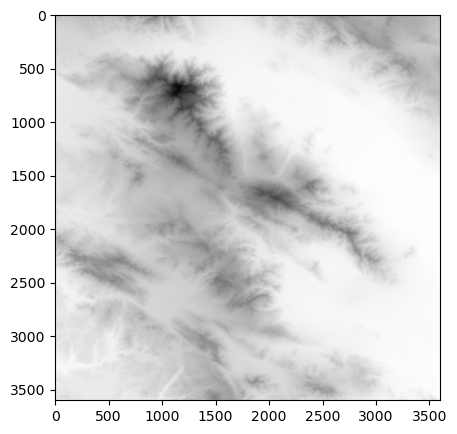

In [18]:
dem1 = rasterio.open('/Users/sra/Desktop/Data_Science_2023/_capstone/1.capstone_data/srtm_1arcs/n33_w117_1arc_v3.tif')
ax = plt.subplots(figsize=(10, 5))
plt.imshow(dem1.read(1), cmap="Greys")
plt.show()

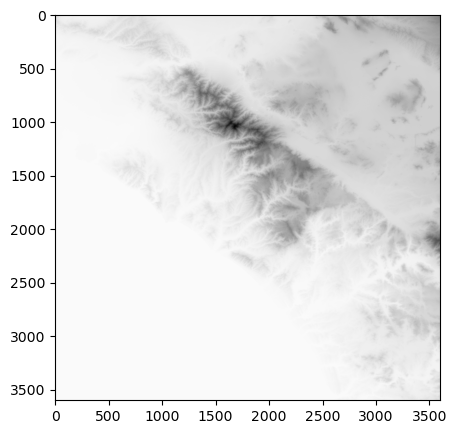

In [16]:
dem2 = rasterio.open('/Users/sra/Desktop/Data_Science_2023/_capstone/1.capstone_data/srtm_1arcs/n33_w118_1arc_v3.tif')
ax = plt.subplots(figsize=(10, 5))
plt.imshow(dem2.read(1), cmap="Greys")
plt.show()

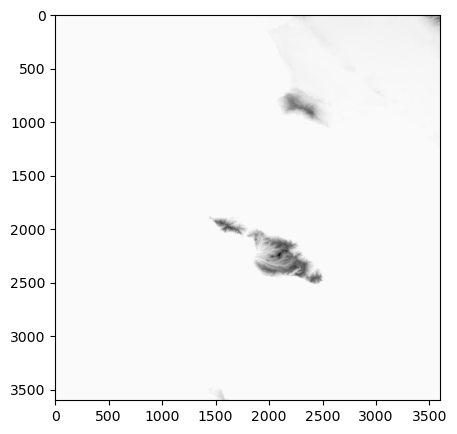

In [19]:
dem2 = rasterio.open('/Users/sra/Desktop/Data_Science_2023/_capstone/1.capstone_data/srtm_1arcs/n33_w119_1arc_v3.tif')
ax = plt.subplots(figsize=(10, 5))
plt.imshow(dem2.read(1), cmap="Greys")
plt.show()


TypeError: scatter() missing 1 required positional argument: 'y'

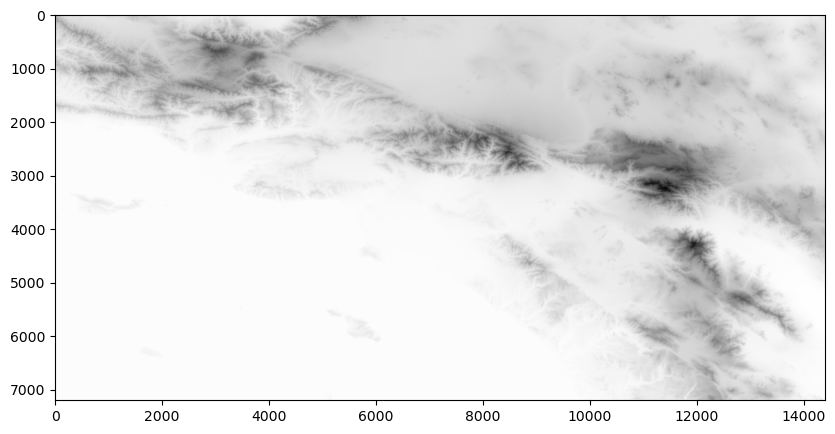

In [36]:
path='/Users/sra/Desktop/Data_Science_2023/_capstone/1.capstone_data/srtm_1arcs/srtm_1arcs.tiff'
dem=rasterio.open(path)
ax = plt.subplots(figsize=(10, 5))
plt.imshow(dem.read(1), cmap="Greys")
plt.show()

In [21]:
import geopandas
import geoplot

In [28]:
# https://residentmario.github.io/geoplot/quickstart/quickstart.html

# Configure matplotlib.
%matplotlib inline

# Unclutter the display.
import pandas as pd
# pd.set_option('max_columns', 6)

import geopandas as gpd

import geoplot as gplt

fire_perim = gpd.read_file('/Users/sra/Desktop/Data_Science_2023/_capstone/1.capstone_data/fire_data/perimeters/full/InterAgencyFirePerimeterHistory_All_Years_View.geojson')
fire_perim

,OBJECTID,MAP_METHOD,DATE_CUR,COMMENTS,GEO_ID,IRWINID,UNQE_FIRE_ID,FIRE_YEAR,LOCAL_NUM,INCIDENT,UNIT_ID,POO_RESP_I,FEATURE_CA,GIS_ACRES,USER_NAME,SOURCE,AGENCY,FIRE_YEAR_INT,Shape__Area,Shape__Length,geometry
0,1,Image Interpretation,20210903,Perimeter update using Sentinel-2 imagery.,1,{9FABE71D-843F-4624-859C-A7EC4A72AB89},2021-AKUYD-000223,2021,000223,Cultas Creek,AKYCP,AKUYD,Wildfire Final Perimeter,40450.000000,None,AICC,AFS,2021.0,9.273137e+08,528166.832442,"POLYGON ((-142.81944 65.16774, -142.81904 65.1..."
1,2,Image Interpretation,20210903,Perimeter updated using Sentinel-2 imagery.,2,{C5ED6535-8217-4130-B795-E81AE6BF02D1},2021-AKUYD-000309,2021,000309,Crescent Creek,AKYCP,AKUYD,Wildfire Final Perimeter,1384.000000,None,AICC,AFS,2021.0,3.115264e+07,56968.266410,"POLYGON ((-143.66148 64.97452, -143.65997 64.9..."
2,3,Image Interpretation,20210901,Perimeter updated using Sentinel-2 imagery.,3,{D9F72569-F8CD-45DB-93F7-D7D05C4F4723},2021-AKFAS-000397,2021,000397,Salcha River 2,AKDNS,AKFAS,Wildfire Final Perimeter,2828.100000,None,AICC,DOF,2021.0,6.324108e+07,118033.611976,"MULTIPOLYGON (((-145.24616 64.90080, -145.2455..."
3,4,Image Interpretation,20210901,Perimeter updated using Sentinel-2 imagery.,4,{3B2C6FF0-CE08-4960-AC83-45DC5687A090},2021-AKUYD-000405,2021,000405,Whitefish Lake,AKYFR,AKUYD,Wildfire Final Perimeter,417.500000,None,AICC,AFS,2021.0,1.036802e+07,16248.978885,"POLYGON ((-142.40339 66.24461, -142.40385 66.2..."
4,5,Image Interpretation,20210901,Perimeter updated using Sentinel-2 imagery.,5,{C0CFD381-B561-4704-BA86-311CF4BE126D},2021-AKUYD-000399,2021,000399,South Fork,AKEID,AKUYD,Wildfire Final Perimeter,884.600000,None,AICC,AFS,2021.0,2.040334e+07,44186.061518,"POLYGON ((-144.39133 65.30406, -144.39133 65.3..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
125675,125691,GPS-Walked,202105171330,None,{517AAA9D-62F9-4888-8C4D-8C77149A4A13},{74A91A8C-55CE-4C46-A385-87243819C0C1},2021-MTNWS-000286,2021,000286,Coyote,MTNWS,MTNWS,Wildfire Daily Fire Perimeter,1.161029,aking_nifc,WFIGS,DNRC,2021.0,1.054388e+04,496.477170,"POLYGON ((-113.98955 48.14013, -113.98958 48.1..."
125676,125692,Auto-generated,202105272211,Auto-generated by EGP-IRWIN,{15D2ADB9-5502-47BA-A9F5-7CC319BD5FEC},{3FA0C291-950E-4AD9-B127-4C312A8AAA6B},2021-MEMES-21003498,2021,21003498,Lily Pond,MEMES,MEMES,Wildfire Daily Fire Perimeter,0.257079,jcousins_nifc,WFIGS,SFS,2021.0,2.026703e+03,201.291769,"POLYGON ((-68.66473 44.23053, -68.66475 44.230..."
125677,125693,Mixed Methods,202106211902,None,{19F6EDF6-9E59-4CA5-9E9B-74826AC9F9F7},{9B1E6F33-DBB9-409A-9A8E-07D980611130},2021-CABTU-007844,2021,007844,PARK,None,CABTU,Wildfire Daily Fire Perimeter,399.558800,akirsch_nifc,WFIGS,None,2021.0,2.740989e+06,8463.546256,"POLYGON ((-121.77830 39.77173, -121.77848 39.7..."
125678,125694,Mixed Methods,202107012143,None,{9EA329B0-5A12-498F-B2A9-EB4334714DB6},{842B03F5-C5EF-45BA-9D4D-9DE8E13F96B2},2021-WYNAX-210210,2021,210210,Lone tree 3,None,WYNAX,Wildfire Daily Fire Perimeter,0.168202,NIFC_Admin,WFIGS,None,2021.0,1.257000e+03,206.304774,"MULTIPOLYGON (((-106.65601 42.60048, -106.6560..."


/Applications/Anaconda/anaconda3/lib/python3.9/site-packages/geoplot/geoplot.py:885: ShapelyDeprecationWarning: Iteration over multi-part geometries is deprecated and will be removed in Shapely 2.0. Use the `geoms` property to access the constituent parts of a multi-part geometry.
  for subgeom in geom:


AttributeError: 'NoneType' object has no attribute 'exterior'

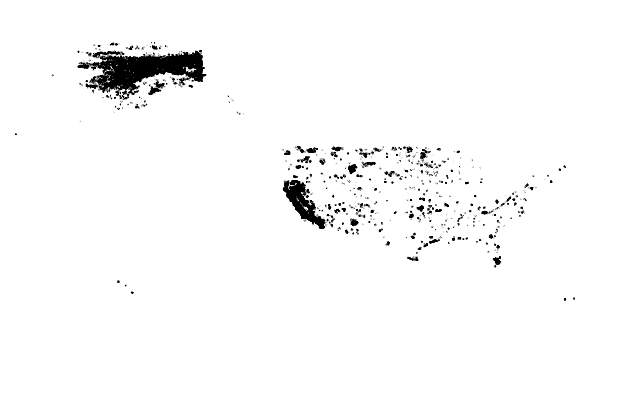

In [29]:
gplt.polyplot()

In [1]:
# https://stackoverflow.com/questions/57000606/create-equally-spaced-coordinates-on-a-california-state-map-created-with-basemap

import numpy as np
from shapely.geometry import Point
from shapely.ops import cascaded_union
import geopandas as gpd

def generate_grid_in_polygon(spacing, polygon):
    ''' This Function generates evenly spaced points within the given GeoDataFrame.
        The parameter 'spacing' defines the distance between the points in coordinate units. '''
    
    # Convert the GeoDataFrame to a single polygon
    poly_in = cascaded_union([poly for poly in polygon.geometry])

    # Get the bounds of the polygon
    minx, miny, maxx, maxy = poly_in.bounds    
    
    # Now generate the entire grid
    x_coords = list(np.arange(np.floor(minx), int(np.ceil(maxx)), spacing))
    y_coords = list(np.arange(np.floor(miny), int(np.ceil(maxy)), spacing))
    
    grid = [Point(x) for x in zip(np.meshgrid(x_coords, y_coords)[0].flatten(), np.meshgrid(x_coords, y_coords)[1].flatten())]
    
    # Finally only keep the points within the polygon
    list_of_points = [point for point in grid if point.within(poly_in)]

    return list_of_points

# shape_in = gpd.read_file('/Users/sra/Desktop/Data_Science_2023/_capstone/1.capstone_data/misc_assets/ca-state-boundary/CA_State_TIGER2016.shp')

# points_in_poly = generate_grid_in_polygon(1, shape_in)
# points_in_poly_gdf = gpd.GeoDataFrame(geometry=points_in_poly)

# ax1 = shape_in.plot(facecolor='none', edgecolor='k')
# ax1 = points_in_poly_gdf.plot(ax=ax1)

In [6]:
# https://gis.stackexchange.com/questions/247231/rasterio-tool-for-creating-mosaic

# import rasterio
# import numpy as np
# from rasterio.merge import merge
# from rasterio.plot import show

# src1 = rasterio.open('/Users/sra/Desktop/Data_Science_2023/_capstone/1.capstone_data/orthoimagery/_loaded/m_3311805_ne_11_060_20180723/m_3311805_ne_11_060_20180723.tif')
# src2 = rasterio.open('/Users/sra/Desktop/Data_Science_2023/_capstone/1.capstone_data/orthoimagery/_loaded/m_3311805_nw_11_060_20180722/m_3311805_nw_11_060_20180722.tif')

# # Taking a peek to make sure these are the rasters you want...
# show(src1)
# show(src2)

# srcs_to_mosaic = [src1, src2]

# # The merge function returns a single array and the affine transform info
# arr, out_trans = merge(srcs_to_mosaic)

# show(arr) # Check to make sure the merge looks good.

In [2]:
# https://medium.com/spatial-data-science/how-to-mosaic-merge-raster-data-in-python-fb18e44f3c8

# import osgeo
from rasterio.plot import show
# from rasterio.merge import merge
# import rasterio as rio
# from pathlib import Path
# path = Path('/Users/sra/Desktop/Data_Science_2023/_capstone/1.capstone_data/orthoimagery')
# Path('output').mkdir(parents=True, exist_ok=True)
# output_path = 'output/mosaic_output.tif'

# # iterate over available .tif files
# raster_files=list(path.iterdir())
# raster_to_mosaic=[]

# # loop through the raster files
# for p in raster_files:
#     raster = rio.open(p)
#     raster_to_mosiac.append(raster)
    
# # merge() method
# mosaic, output = merge(raster_to_mosiac)

# # copy raster's metadata and update it
# # to match height and width of mosaic
# output_meta = raster.meta.copy()
# output_meta.update(
#     {"driver": "GTiff",
#         "height": mosaic.shape[1],
#         "width": mosaic.shape[2],
#         "transform": output,
#     }
# )

# # write mosaiced file in a local folder
# with rio.open(output_path, “w”, **output_meta) as m:
#     m.write(mosaic)

ImportError: cannot import name dtypes

In [9]:
%conda install rasterio

Solving environment: done

# All requested packages already installed.


Note: you may need to restart the kernel to use updated packages.


In [1]:
! python --version

Python 3.10.8


In [2]:
df_points_0001=gpd.read_file('/Users/sra/Desktop/Data_Science_2023/_capstone/1.capstone_data/misc_assets/santa_monica_regular_points_0001.geojson')
df_points_0001

,id,geometry
0,0,POINT (-119.09300 34.17500)
1,1,POINT (-119.09290 34.17500)
2,2,POINT (-119.09280 34.17500)
3,3,POINT (-119.09270 34.17500)
4,4,POINT (-119.09260 34.17500)
...,...,...
14349995,14349995,POINT (-118.27350 34.00010)
14349996,14349996,POINT (-118.27340 34.00010)
14349997,14349997,POINT (-118.27330 34.00010)
14349998,14349998,POINT (-118.27320 34.00010)


In [5]:
df_points_005=gpd.read_file('\
/Users/sra/Desktop/Data_Science_2023/_capstone/1.capstone_data/misc_assets/santa_monica_regular_points_005.geojson')
df_points_005

,id,geometry
0,0,POINT (-119.09300 34.17500)
1,1,POINT (-119.08800 34.17500)
2,2,POINT (-119.08300 34.17500)
3,3,POINT (-119.07800 34.17500)
4,4,POINT (-119.07300 34.17500)
...,...,...
5935,5935,POINT (-118.29300 34.00000)
5936,5936,POINT (-118.28800 34.00000)
5937,5937,POINT (-118.28300 34.00000)
5938,5938,POINT (-118.27800 34.00000)


In [13]:
df_points_005_perim03=gpd.read_file(\
'/Users/sra/Desktop/Data_Science_2023/_capstone/1.capstone_data/santa_monica_005_perim03.geojson')
df_points_005_perim03

,id,perim_OBJECTID,perim_MAP_METHOD,perim_DATE_CUR,perim_COMMENTS,perim_GEO_ID,perim_IRWINID,perim_UNQE_FIRE_,perim_FIRE_YEAR,perim_LOCAL_NUM,...,perim_POO_RESP_I,perim_FEATURE_CA,perim_GIS_ACRES,perim_USER_NAME,perim_SOURCE,perim_AGENCY,perim_FIRE_YEAR_,perim_Shape__Are,perim_Shape__Len,geometry
0,0,NaN,None,None,None,None,None,None,None,None,...,None,None,NaN,None,None,None,NaN,NaN,NaN,POINT (-119.09300 34.17500)
1,1,NaN,None,None,None,None,None,None,None,None,...,None,None,NaN,None,None,None,NaN,NaN,NaN,POINT (-119.08800 34.17500)
2,2,NaN,None,None,None,None,None,None,None,None,...,None,None,NaN,None,None,None,NaN,NaN,NaN,POINT (-119.08300 34.17500)
3,3,NaN,None,None,None,None,None,None,None,None,...,None,None,NaN,None,None,None,NaN,NaN,NaN,POINT (-119.07800 34.17500)
4,4,NaN,None,None,None,None,None,None,None,None,...,None,None,NaN,None,None,None,NaN,NaN,NaN,POINT (-119.07300 34.17500)
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5935,5935,NaN,None,None,None,None,None,None,None,None,...,None,None,NaN,None,None,None,NaN,NaN,NaN,POINT (-118.29300 34.00000)
5936,5936,NaN,None,None,None,None,None,None,None,None,...,None,None,NaN,None,None,None,NaN,NaN,NaN,POINT (-118.28800 34.00000)
5937,5937,NaN,None,None,None,None,None,None,None,None,...,None,None,NaN,None,None,None,NaN,NaN,NaN,POINT (-118.28300 34.00000)
5938,5938,NaN,None,None,None,None,None,None,None,None,...,None,None,NaN,None,None,None,NaN,NaN,NaN,POINT (-118.27800 34.00000)


In [12]:
df_points_005_perim03.loc[10,"perim_COMMENTS"]

'2013-CASMP-416  Ventura Co 13-25314, Perim based on BARC interp and field recon'

In [15]:
df_points_005_perim02=gpd.read_file(\
'/Users/sra/Desktop/Data_Science_2023/_capstone/1.capstone_data/santa_monica_005_perim02.geojson')
df_points_005_perim02

,id,id_2,perim_OBJECTID,perim_MAP_METHOD,perim_DATE_CUR,perim_COMMENTS,perim_GEO_ID,perim_IRWINID,perim_UNQE_FIRE_,perim_FIRE_YEAR,...,perim_POO_RESP_I,perim_FEATURE_CA,perim_GIS_ACRES,perim_USER_NAME,perim_SOURCE,perim_AGENCY,perim_FIRE_YEAR_,perim_Shape__Are,perim_Shape__Len,geometry
0,0,0,4751,Mixed Collection Methods,20070508,NPS from BARC imagery and air photo interp. Pr...,21990,None,2007-CALAC-00000000,2007,...,None,Wildfire,747.89840,None,CalFire FRAP,LRA,2007,4.427910e+06,15010.918614,POINT (-119.09300 34.17500)
1,1,0,4751,Mixed Collection Methods,20070508,NPS from BARC imagery and air photo interp. Pr...,21990,None,2007-CALAC-00000000,2007,...,None,Wildfire,747.89840,None,CalFire FRAP,LRA,2007,4.427910e+06,15010.918614,POINT (-119.08800 34.17500)
2,2,0,4751,Mixed Collection Methods,20070508,NPS from BARC imagery and air photo interp. Pr...,21990,None,2007-CALAC-00000000,2007,...,None,Wildfire,747.89840,None,CalFire FRAP,LRA,2007,4.427910e+06,15010.918614,POINT (-119.08300 34.17500)
3,3,0,4751,Mixed Collection Methods,20070508,NPS from BARC imagery and air photo interp. Pr...,21990,None,2007-CALAC-00000000,2007,...,None,Wildfire,747.89840,None,CalFire FRAP,LRA,2007,4.427910e+06,15010.918614,POINT (-119.07800 34.17500)
4,4,0,4751,Mixed Collection Methods,20070508,NPS from BARC imagery and air photo interp. Pr...,21990,None,2007-CALAC-00000000,2007,...,None,Wildfire,747.89840,None,CalFire FRAP,LRA,2007,4.427910e+06,15010.918614,POINT (-119.07300 34.17500)
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6438955,5935,0,125688,Mixed Methods,202105042256,None,{6311DB3C-2505-4254-870F-3A4D6C013A63},{7C1A0BF5-E052-4EAA-BF42-14F22FCF673E},2018-CALFD-000934,2018,...,CALFD,Wildfire Daily Fire Perimeter,18.03931,NIFC_Authoritative,WFIGS,CDF,2018,1.067886e+05,1755.437188,POINT (-118.29300 34.00000)
6438956,5936,0,125688,Mixed Methods,202105042256,None,{6311DB3C-2505-4254-870F-3A4D6C013A63},{7C1A0BF5-E052-4EAA-BF42-14F22FCF673E},2018-CALFD-000934,2018,...,CALFD,Wildfire Daily Fire Perimeter,18.03931,NIFC_Authoritative,WFIGS,CDF,2018,1.067886e+05,1755.437188,POINT (-118.28800 34.00000)
6438957,5937,0,125688,Mixed Methods,202105042256,None,{6311DB3C-2505-4254-870F-3A4D6C013A63},{7C1A0BF5-E052-4EAA-BF42-14F22FCF673E},2018-CALFD-000934,2018,...,CALFD,Wildfire Daily Fire Perimeter,18.03931,NIFC_Authoritative,WFIGS,CDF,2018,1.067886e+05,1755.437188,POINT (-118.28300 34.00000)
6438958,5938,0,125688,Mixed Methods,202105042256,None,{6311DB3C-2505-4254-870F-3A4D6C013A63},{7C1A0BF5-E052-4EAA-BF42-14F22FCF673E},2018-CALFD-000934,2018,...,CALFD,Wildfire Daily Fire Perimeter,18.03931,NIFC_Authoritative,WFIGS,CDF,2018,1.067886e+05,1755.437188,POINT (-118.27800 34.00000)


In [7]:
set(df_points_005_perim['id'] & df_points_005_perim['id_2'])

{0}

In [8]:
df_points_005_perim['id_2'].value_counts()

0    6438960
Name: id_2, dtype: int64

In [24]:
df_points_005_perim02.iloc[:15,:]

,id,id_2,perim_OBJECTID,perim_MAP_METHOD,perim_DATE_CUR,perim_COMMENTS,perim_GEO_ID,perim_IRWINID,perim_UNQE_FIRE_,perim_FIRE_YEAR,...,perim_POO_RESP_I,perim_FEATURE_CA,perim_GIS_ACRES,perim_USER_NAME,perim_SOURCE,perim_AGENCY,perim_FIRE_YEAR_,perim_Shape__Are,perim_Shape__Len,geometry
0,0,0,4751,Mixed Collection Methods,20070508,NPS from BARC imagery and air photo interp. Pr...,21990,None,2007-CALAC-00000000,2007,...,None,Wildfire,747.8984,None,CalFire FRAP,LRA,2007,4427910.25,15010.918614,POINT (-119.09300 34.17500)
1,1,0,4751,Mixed Collection Methods,20070508,NPS from BARC imagery and air photo interp. Pr...,21990,None,2007-CALAC-00000000,2007,...,None,Wildfire,747.8984,None,CalFire FRAP,LRA,2007,4427910.25,15010.918614,POINT (-119.08800 34.17500)
2,2,0,4751,Mixed Collection Methods,20070508,NPS from BARC imagery and air photo interp. Pr...,21990,None,2007-CALAC-00000000,2007,...,None,Wildfire,747.8984,None,CalFire FRAP,LRA,2007,4427910.25,15010.918614,POINT (-119.08300 34.17500)
3,3,0,4751,Mixed Collection Methods,20070508,NPS from BARC imagery and air photo interp. Pr...,21990,None,2007-CALAC-00000000,2007,...,None,Wildfire,747.8984,None,CalFire FRAP,LRA,2007,4427910.25,15010.918614,POINT (-119.07800 34.17500)
4,4,0,4751,Mixed Collection Methods,20070508,NPS from BARC imagery and air photo interp. Pr...,21990,None,2007-CALAC-00000000,2007,...,None,Wildfire,747.8984,None,CalFire FRAP,LRA,2007,4427910.25,15010.918614,POINT (-119.07300 34.17500)
5,5,0,4751,Mixed Collection Methods,20070508,NPS from BARC imagery and air photo interp. Pr...,21990,None,2007-CALAC-00000000,2007,...,None,Wildfire,747.8984,None,CalFire FRAP,LRA,2007,4427910.25,15010.918614,POINT (-119.06800 34.17500)
6,6,0,4751,Mixed Collection Methods,20070508,NPS from BARC imagery and air photo interp. Pr...,21990,None,2007-CALAC-00000000,2007,...,None,Wildfire,747.8984,None,CalFire FRAP,LRA,2007,4427910.25,15010.918614,POINT (-119.06300 34.17500)
7,7,0,4751,Mixed Collection Methods,20070508,NPS from BARC imagery and air photo interp. Pr...,21990,None,2007-CALAC-00000000,2007,...,None,Wildfire,747.8984,None,CalFire FRAP,LRA,2007,4427910.25,15010.918614,POINT (-119.05800 34.17500)
8,8,0,4751,Mixed Collection Methods,20070508,NPS from BARC imagery and air photo interp. Pr...,21990,None,2007-CALAC-00000000,2007,...,None,Wildfire,747.8984,None,CalFire FRAP,LRA,2007,4427910.25,15010.918614,POINT (-119.05300 34.17500)
9,9,0,4751,Mixed Collection Methods,20070508,NPS from BARC imagery and air photo interp. Pr...,21990,None,2007-CALAC-00000000,2007,...,None,Wildfire,747.8984,None,CalFire FRAP,LRA,2007,4427910.25,15010.918614,POINT (-119.04800 34.17500)


In [18]:
pd.set_option('display.max_rows', None)

In [28]:
sm_perim_join_contain=gpd.read_file('/Users/sra/Desktop/Data_Science_2023/_capstone/1.capstone_data/sm_perim_join_contain.geojson')
sm_perim_join_contain

,OBJECTID,MAP_METHOD,DATE_CUR,COMMENTS,GEO_ID,IRWINID,UNQE_FIRE_,FIRE_YEAR,LOCAL_NUM,INCIDENT,...,FEATURE_CA,GIS_ACRES,USER_NAME,SOURCE,AGENCY,FIRE_YEAR_,Shape__Are,Shape__Len,id,geometry
0,4751,Mixed Collection Methods,20070508,NPS from BARC imagery and air photo interp. Pr...,21990,None,2007-CALAC-00000000,2007,00000000,GRIFFITH PARK,...,Wildfire,747.898400,None,CalFire FRAP,LRA,2007,4.427910e+06,15010.918614,1644.0,"MULTIPOLYGON (((-118.29765 34.13506, -118.2970..."
1,4751,Mixed Collection Methods,20070508,NPS from BARC imagery and air photo interp. Pr...,21990,None,2007-CALAC-00000000,2007,00000000,GRIFFITH PARK,...,Wildfire,747.898400,None,CalFire FRAP,LRA,2007,4.427910e+06,15010.918614,1645.0,"MULTIPOLYGON (((-118.29765 34.13506, -118.2970..."
2,4751,Mixed Collection Methods,20070508,NPS from BARC imagery and air photo interp. Pr...,21990,None,2007-CALAC-00000000,2007,00000000,GRIFFITH PARK,...,Wildfire,747.898400,None,CalFire FRAP,LRA,2007,4.427910e+06,15010.918614,1646.0,"MULTIPOLYGON (((-118.29765 34.13506, -118.2970..."
3,4751,Mixed Collection Methods,20070508,NPS from BARC imagery and air photo interp. Pr...,21990,None,2007-CALAC-00000000,2007,00000000,GRIFFITH PARK,...,Wildfire,747.898400,None,CalFire FRAP,LRA,2007,4.427910e+06,15010.918614,1647.0,"MULTIPOLYGON (((-118.29765 34.13506, -118.2970..."
4,4751,Mixed Collection Methods,20070508,NPS from BARC imagery and air photo interp. Pr...,21990,None,2007-CALAC-00000000,2007,00000000,GRIFFITH PARK,...,Wildfire,747.898400,None,CalFire FRAP,LRA,2007,4.427910e+06,15010.918614,1648.0,"MULTIPOLYGON (((-118.29765 34.13506, -118.2970..."
5,4751,Mixed Collection Methods,20070508,NPS from BARC imagery and air photo interp. Pr...,21990,None,2007-CALAC-00000000,2007,00000000,GRIFFITH PARK,...,Wildfire,747.898400,None,CalFire FRAP,LRA,2007,4.427910e+06,15010.918614,1809.0,"MULTIPOLYGON (((-118.29765 34.13506, -118.2970..."
6,4751,Mixed Collection Methods,20070508,NPS from BARC imagery and air photo interp. Pr...,21990,None,2007-CALAC-00000000,2007,00000000,GRIFFITH PARK,...,Wildfire,747.898400,None,CalFire FRAP,LRA,2007,4.427910e+06,15010.918614,1810.0,"MULTIPOLYGON (((-118.29765 34.13506, -118.2970..."
7,4751,Mixed Collection Methods,20070508,NPS from BARC imagery and air photo interp. Pr...,21990,None,2007-CALAC-00000000,2007,00000000,GRIFFITH PARK,...,Wildfire,747.898400,None,CalFire FRAP,LRA,2007,4.427910e+06,15010.918614,1811.0,"MULTIPOLYGON (((-118.29765 34.13506, -118.2970..."
8,4751,Mixed Collection Methods,20070508,NPS from BARC imagery and air photo interp. Pr...,21990,None,2007-CALAC-00000000,2007,00000000,GRIFFITH PARK,...,Wildfire,747.898400,None,CalFire FRAP,LRA,2007,4.427910e+06,15010.918614,1812.0,"MULTIPOLYGON (((-118.29765 34.13506, -118.2970..."
9,4751,Mixed Collection Methods,20070508,NPS from BARC imagery and air photo interp. Pr...,21990,None,2007-CALAC-00000000,2007,00000000,GRIFFITH PARK,...,Wildfire,747.898400,None,CalFire FRAP,LRA,2007,4.427910e+06,15010.918614,1813.0,"MULTIPOLYGON (((-118.29765 34.13506, -118.2970..."


In [29]:
sm_perim_join_contain.head(100)

,OBJECTID,MAP_METHOD,DATE_CUR,COMMENTS,GEO_ID,IRWINID,UNQE_FIRE_,FIRE_YEAR,LOCAL_NUM,INCIDENT,...,FEATURE_CA,GIS_ACRES,USER_NAME,SOURCE,AGENCY,FIRE_YEAR_,Shape__Are,Shape__Len,id,geometry
0,4751,Mixed Collection Methods,20070508,NPS from BARC imagery and air photo interp. Pr...,21990,None,2007-CALAC-00000000,2007,00000000,GRIFFITH PARK,...,Wildfire,747.898400,None,CalFire FRAP,LRA,2007,4.427910e+06,15010.918614,1644.0,"MULTIPOLYGON (((-118.29765 34.13506, -118.2970..."
1,4751,Mixed Collection Methods,20070508,NPS from BARC imagery and air photo interp. Pr...,21990,None,2007-CALAC-00000000,2007,00000000,GRIFFITH PARK,...,Wildfire,747.898400,None,CalFire FRAP,LRA,2007,4.427910e+06,15010.918614,1645.0,"MULTIPOLYGON (((-118.29765 34.13506, -118.2970..."
2,4751,Mixed Collection Methods,20070508,NPS from BARC imagery and air photo interp. Pr...,21990,None,2007-CALAC-00000000,2007,00000000,GRIFFITH PARK,...,Wildfire,747.898400,None,CalFire FRAP,LRA,2007,4.427910e+06,15010.918614,1646.0,"MULTIPOLYGON (((-118.29765 34.13506, -118.2970..."
3,4751,Mixed Collection Methods,20070508,NPS from BARC imagery and air photo interp. Pr...,21990,None,2007-CALAC-00000000,2007,00000000,GRIFFITH PARK,...,Wildfire,747.898400,None,CalFire FRAP,LRA,2007,4.427910e+06,15010.918614,1647.0,"MULTIPOLYGON (((-118.29765 34.13506, -118.2970..."
4,4751,Mixed Collection Methods,20070508,NPS from BARC imagery and air photo interp. Pr...,21990,None,2007-CALAC-00000000,2007,00000000,GRIFFITH PARK,...,Wildfire,747.898400,None,CalFire FRAP,LRA,2007,4.427910e+06,15010.918614,1648.0,"MULTIPOLYGON (((-118.29765 34.13506, -118.2970..."
5,4751,Mixed Collection Methods,20070508,NPS from BARC imagery and air photo interp. Pr...,21990,None,2007-CALAC-00000000,2007,00000000,GRIFFITH PARK,...,Wildfire,747.898400,None,CalFire FRAP,LRA,2007,4.427910e+06,15010.918614,1809.0,"MULTIPOLYGON (((-118.29765 34.13506, -118.2970..."
6,4751,Mixed Collection Methods,20070508,NPS from BARC imagery and air photo interp. Pr...,21990,None,2007-CALAC-00000000,2007,00000000,GRIFFITH PARK,...,Wildfire,747.898400,None,CalFire FRAP,LRA,2007,4.427910e+06,15010.918614,1810.0,"MULTIPOLYGON (((-118.29765 34.13506, -118.2970..."
7,4751,Mixed Collection Methods,20070508,NPS from BARC imagery and air photo interp. Pr...,21990,None,2007-CALAC-00000000,2007,00000000,GRIFFITH PARK,...,Wildfire,747.898400,None,CalFire FRAP,LRA,2007,4.427910e+06,15010.918614,1811.0,"MULTIPOLYGON (((-118.29765 34.13506, -118.2970..."
8,4751,Mixed Collection Methods,20070508,NPS from BARC imagery and air photo interp. Pr...,21990,None,2007-CALAC-00000000,2007,00000000,GRIFFITH PARK,...,Wildfire,747.898400,None,CalFire FRAP,LRA,2007,4.427910e+06,15010.918614,1812.0,"MULTIPOLYGON (((-118.29765 34.13506, -118.2970..."
9,4751,Mixed Collection Methods,20070508,NPS from BARC imagery and air photo interp. Pr...,21990,None,2007-CALAC-00000000,2007,00000000,GRIFFITH PARK,...,Wildfire,747.898400,None,CalFire FRAP,LRA,2007,4.427910e+06,15010.918614,1813.0,"MULTIPOLYGON (((-118.29765 34.13506, -118.2970..."


In [38]:
sm_perim_join_contain.shape

(17087, 22)

In [39]:
sm_perim_join_contain[sm_perim_join_contain['id']==1643]

,OBJECTID,MAP_METHOD,DATE_CUR,COMMENTS,GEO_ID,IRWINID,UNQE_FIRE_,FIRE_YEAR,LOCAL_NUM,INCIDENT,...,FEATURE_CA,GIS_ACRES,USER_NAME,SOURCE,AGENCY,FIRE_YEAR_,Shape__Are,Shape__Len,id,geometry
210,11860,None,19291220,None,23163,None,1929-CALAC-00000000,1929,00000000,GRIFFITH PARK 113A,...,Wildfire,451.8104,None,CalFire FRAP,CCO,1929,2.675086e+06,9649.142179,1643.0,"MULTIPOLYGON (((-118.29413 34.13414, -118.2942..."
3990,13147,None,19610513,None,31521,None,1961-CALAC-00000000,1961,00000000,None,...,Wildfire,847.1669,None,CalFire FRAP,CCO,1961,5.015849e+06,15010.532681,1643.0,"MULTIPOLYGON (((-118.30191 34.13754, -118.3017..."
11938,94239,None,201901020000,None,54719691,None,00000000,1929,None,GRIFFITH PARK 113A,...,Wildfire Final Perimeter,451.8100,None,USFS,USFS,1929,2.675086e+06,9649.141790,1643.0,"MULTIPOLYGON (((-118.29413 34.13414, -118.2942..."
16017,109261,None,201901020000,None,54727396,None,00000000,1961,None,None,...,Wildfire Final Perimeter,847.1670,None,USFS,USFS,1961,5.015849e+06,15010.533111,1643.0,"MULTIPOLYGON (((-118.30191 34.13754, -118.3017..."


In [40]:
sm_elevasp_perim_join_contain=gpd.read_file('/Users/sra/Desktop/Data_Science_2023/_capstone/1.capstone_data/sm_elevasp_perim_join_contain.geojson')
sm_elevasp_perim_join_contain.head(10)

,OBJECTID,MAP_METHOD,DATE_CUR,COMMENTS,GEO_ID,IRWINID,UNQE_FIRE_,FIRE_YEAR,LOCAL_NUM,INCIDENT,...,USER_NAME,SOURCE,AGENCY,FIRE_YEAR_,Shape__Are,Shape__Len,_perimid,_perimelevation_1,_perimaspect_1,geometry
0,4751,Mixed Collection Methods,20070508,NPS from BARC imagery and air photo interp. Pr...,21990,None,2007-CALAC-00000000,2007,00000000,GRIFFITH PARK,...,None,CalFire FRAP,LRA,2007,4427910.25,15010.918614,1644.0,434.0,31.883564,"MULTIPOLYGON (((-118.29765 34.13506, -118.2970..."
1,4751,Mixed Collection Methods,20070508,NPS from BARC imagery and air photo interp. Pr...,21990,None,2007-CALAC-00000000,2007,00000000,GRIFFITH PARK,...,None,CalFire FRAP,LRA,2007,4427910.25,15010.918614,1645.0,349.0,7.624194,"MULTIPOLYGON (((-118.29765 34.13506, -118.2970..."
2,4751,Mixed Collection Methods,20070508,NPS from BARC imagery and air photo interp. Pr...,21990,None,2007-CALAC-00000000,2007,00000000,GRIFFITH PARK,...,None,CalFire FRAP,LRA,2007,4427910.25,15010.918614,1646.0,288.0,72.613029,"MULTIPOLYGON (((-118.29765 34.13506, -118.2970..."
3,4751,Mixed Collection Methods,20070508,NPS from BARC imagery and air photo interp. Pr...,21990,None,2007-CALAC-00000000,2007,00000000,GRIFFITH PARK,...,None,CalFire FRAP,LRA,2007,4427910.25,15010.918614,1647.0,189.0,335.170654,"MULTIPOLYGON (((-118.29765 34.13506, -118.2970..."
4,4751,Mixed Collection Methods,20070508,NPS from BARC imagery and air photo interp. Pr...,21990,None,2007-CALAC-00000000,2007,00000000,GRIFFITH PARK,...,None,CalFire FRAP,LRA,2007,4427910.25,15010.918614,1648.0,229.0,346.464142,"MULTIPOLYGON (((-118.29765 34.13506, -118.2970..."
5,4751,Mixed Collection Methods,20070508,NPS from BARC imagery and air photo interp. Pr...,21990,None,2007-CALAC-00000000,2007,00000000,GRIFFITH PARK,...,None,CalFire FRAP,LRA,2007,4427910.25,15010.918614,1809.0,318.0,159.775146,"MULTIPOLYGON (((-118.29765 34.13506, -118.2970..."
6,4751,Mixed Collection Methods,20070508,NPS from BARC imagery and air photo interp. Pr...,21990,None,2007-CALAC-00000000,2007,00000000,GRIFFITH PARK,...,None,CalFire FRAP,LRA,2007,4427910.25,15010.918614,1810.0,304.0,136.218872,"MULTIPOLYGON (((-118.29765 34.13506, -118.2970..."
7,4751,Mixed Collection Methods,20070508,NPS from BARC imagery and air photo interp. Pr...,21990,None,2007-CALAC-00000000,2007,00000000,GRIFFITH PARK,...,None,CalFire FRAP,LRA,2007,4427910.25,15010.918614,1811.0,352.0,284.743561,"MULTIPOLYGON (((-118.29765 34.13506, -118.2970..."
8,4751,Mixed Collection Methods,20070508,NPS from BARC imagery and air photo interp. Pr...,21990,None,2007-CALAC-00000000,2007,00000000,GRIFFITH PARK,...,None,CalFire FRAP,LRA,2007,4427910.25,15010.918614,1812.0,324.0,356.633545,"MULTIPOLYGON (((-118.29765 34.13506, -118.2970..."
9,4751,Mixed Collection Methods,20070508,NPS from BARC imagery and air photo interp. Pr...,21990,None,2007-CALAC-00000000,2007,00000000,GRIFFITH PARK,...,None,CalFire FRAP,LRA,2007,4427910.25,15010.918614,1813.0,258.0,82.874985,"MULTIPOLYGON (((-118.29765 34.13506, -118.2970..."


In [42]:
sm_elevasp_perim_join_contain.shape
sm_elevasp_perim_join_contain[sm_elevasp_perim_join_contain['_perimid']==1643]

,OBJECTID,MAP_METHOD,DATE_CUR,COMMENTS,GEO_ID,IRWINID,UNQE_FIRE_,FIRE_YEAR,LOCAL_NUM,INCIDENT,...,USER_NAME,SOURCE,AGENCY,FIRE_YEAR_,Shape__Are,Shape__Len,_perimid,_perimelevation_1,_perimaspect_1,geometry
210,11860,None,19291220,None,23163,None,1929-CALAC-00000000,1929,00000000,GRIFFITH PARK 113A,...,None,CalFire FRAP,CCO,1929,2.675086e+06,9649.142179,1643.0,425.0,356.308624,"MULTIPOLYGON (((-118.29413 34.13414, -118.2942..."
3990,13147,None,19610513,None,31521,None,1961-CALAC-00000000,1961,00000000,None,...,None,CalFire FRAP,CCO,1961,5.015849e+06,15010.532681,1643.0,425.0,356.308624,"MULTIPOLYGON (((-118.30191 34.13754, -118.3017..."
11938,94239,None,201901020000,None,54719691,None,00000000,1929,None,GRIFFITH PARK 113A,...,None,USFS,USFS,1929,2.675086e+06,9649.141790,1643.0,425.0,356.308624,"MULTIPOLYGON (((-118.29413 34.13414, -118.2942..."
16017,109261,None,201901020000,None,54727396,None,00000000,1961,None,None,...,None,USFS,USFS,1961,5.015849e+06,15010.533111,1643.0,425.0,356.308624,"MULTIPOLYGON (((-118.30191 34.13754, -118.3017..."


In [4]:
wxr_east1=pd.read_csv('/Users/sra/Desktop/Data_Science_2023/_capstone/1.capstone_data/power_climate/2017_2021/csv/POWER_Point_Hourly_20170101_20211231_034d1185N_119d0404W_LST.csv',header=13)
wxr_east1['key']=wxr_east1.index
wxr_east1

,YEAR,MO,DY,HR,WD2M,WS2M,PRECTOTCORR,QV2M,T2MDEW,key
0,2016,12,31,16,269.64,5.04,0.28,6.96,8.37,0
1,2016,12,31,17,281.85,4.76,0.10,6.65,7.69,1
2,2016,12,31,18,302.22,4.22,0.03,6.35,7.05,2
3,2016,12,31,19,318.47,4.20,0.01,5.98,6.27,3
4,2016,12,31,20,327.30,4.02,0.00,5.68,5.51,4
...,...,...,...,...,...,...,...,...,...,...
43819,2021,12,31,11,280.06,3.09,0.00,7.26,8.87,43819
43820,2021,12,31,12,274.96,3.98,0.00,7.20,8.77,43820
43821,2021,12,31,13,277.45,4.28,0.00,7.14,8.63,43821
43822,2021,12,31,14,280.74,4.32,0.00,6.96,8.33,43822


In [5]:
wxr_east2=pd.read_csv('/Users/sra/Desktop/Data_Science_2023/_capstone/1.capstone_data/power_climate/2017_2021/csv/POWER_Point_Hourly_20170101_20211231_034d1185N_119d0404W_LST-2.csv',header=11)
wxr_east2['key']=wxr_east2.index
wxr_east2

,YEAR,MO,DY,HR,T2M,ALLSKY_SFC_PAR_TOT,ALLSKY_SFC_SW_DWN,key
0,2016,12,31,16,10.58,14.85,0.15,0
1,2016,12,31,17,10.37,0.00,0.00,1
2,2016,12,31,18,9.80,0.00,0.00,2
3,2016,12,31,19,9.13,0.00,0.00,3
4,2016,12,31,20,8.56,0.00,0.00,4
...,...,...,...,...,...,...,...,...
43819,2021,12,31,11,14.69,204.52,1.68,43819
43820,2021,12,31,12,15.13,180.02,1.48,43820
43821,2021,12,31,13,15.35,164.48,1.36,43821
43822,2021,12,31,14,15.35,120.65,1.02,43822


In [12]:
wxr_east=pd.merge(wxr_east1,wxr_east2,how='left',on='key')
wxr_east

,YEAR_x,MO_x,DY_x,HR_x,WD2M,WS2M,PRECTOTCORR,QV2M,T2MDEW,key,YEAR_y,MO_y,DY_y,HR_y,T2M,ALLSKY_SFC_PAR_TOT,ALLSKY_SFC_SW_DWN
0,2016,12,31,16,269.64,5.04,0.28,6.96,8.37,0,2016,12,31,16,10.58,14.85,0.15
1,2016,12,31,17,281.85,4.76,0.10,6.65,7.69,1,2016,12,31,17,10.37,0.00,0.00
2,2016,12,31,18,302.22,4.22,0.03,6.35,7.05,2,2016,12,31,18,9.80,0.00,0.00
3,2016,12,31,19,318.47,4.20,0.01,5.98,6.27,3,2016,12,31,19,9.13,0.00,0.00
4,2016,12,31,20,327.30,4.02,0.00,5.68,5.51,4,2016,12,31,20,8.56,0.00,0.00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
43819,2021,12,31,11,280.06,3.09,0.00,7.26,8.87,43819,2021,12,31,11,14.69,204.52,1.68
43820,2021,12,31,12,274.96,3.98,0.00,7.20,8.77,43820,2021,12,31,12,15.13,180.02,1.48
43821,2021,12,31,13,277.45,4.28,0.00,7.14,8.63,43821,2021,12,31,13,15.35,164.48,1.36
43822,2021,12,31,14,280.74,4.32,0.00,6.96,8.33,43822,2021,12,31,14,15.35,120.65,1.02


In [10]:
a=[1,2,3,4,5]
b=[1,2,3,4,5,6]

set(b)-set(a)

{6}

In [15]:
# check to see if the length of the two datasets is the same
set(wxr_east1['key'])-set(wxr_east2['key'])

set()